## This notebook is to annotate new dataset

In [665]:
from F00_global_variables import *
os.chdir('/mnt/08_thymus_cell_atlas/')

sys.path.append('/mnt/thymus_atlas')
import scjp
from scjp import markers, model, draw

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100, color_map='OrRd')
sc.logging.print_version_and_date()
%load_ext autoreload
%autoreload 2
%load_ext rpy2.ipython

version = 'HTA08.v01.A02.'

print('Version: '+version)

Running Scanpy 1.4.3 on 2019-09-21 10:24.
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The rpy2.ipython extension is already loaded. To reload it, use:
  %reload_ext rpy2.ipython
Version: HTA08.v01.A02.


## [save] saved ndata

## Load previous annotation file

In [2]:
fig1 = sc.read('/mnt/02_FCA_ImmunoP/04_Reviewers/A42.v01.fig1.h5ad',backed='r')

Only considering the two last: ['.fig1', '.h5ad'].
Only considering the two last: ['.fig1', '.h5ad'].


## Get sample list

In [9]:
# define sample list
smp_list = [x.strip().split("\t") for x in mouse_10X_list]

In [10]:
ad = {}

In [11]:
raw_file_path =  './01_Matrix/mouse/'

for filename, sample in smp_list:  
    if 'Add' in sample:
        continue
    if sample in ad:
        continue

    path = '%s/%s/'%(raw_file_path,filename)
    adata = sc.read(path+'matrix.mtx.gz',cache=True).transpose()
  
    try: 
        adata.var_names = np.genfromtxt(path + 'genes.tsv.gz',dtype=str)[:,1]
        adata.var['GeneName'] = np.genfromtxt(path + 'genes.tsv.gz', dtype=str)[:, 1]
        adata.var['GeneID'] = np.genfromtxt(path + 'genes.tsv.gz', dtype=str)[:, 0]
    except: 
        adata.var_names = np.genfromtxt(path + 'features.tsv.gz',dtype=str)[:,1]
        adata.var['GeneName'] = np.genfromtxt(path + 'features.tsv.gz', dtype=str)[:, 1]
        adata.var['GeneID'] = np.genfromtxt(path + 'features.tsv.gz', dtype=str)[:, 0]
    adata.obs_names = np.genfromtxt(path + 'barcodes.tsv.gz',dtype=str)
    adata.obs_names = [filename+"-"+x.strip("-1") for x in adata.obs_names]
    adata.obs['Sample'] = sample
    
    # caculate n_counts / n_genes per cell
    adata.obs['n_counts'] = np.sum(adata.X, axis=1).A1
    adata.obs['n_genes'] = np.sum(adata.X>0,axis=1)
    
    # filter cells
    clist = []
    clist.append(np.array(adata.obs['n_counts'] > 2000))
    if 'C34' in sample:
        clist.append(np.array(adata.obs['n_counts'] > 3000))
    clist.append(np.array(adata.obs['n_genes'] > 500))
    clist.append(np.array(adata.obs['n_genes'] < 7000))
    
    c = np.column_stack(clist).all(axis=1)
    adata = adata[c].copy()
    
    adata = adata[:,np.argsort(adata.var.GeneID)]
    
    adata.obs['donor'] = [convert_obs_name(x)[0] for x in adata.obs['Sample']]
    adata.obs['organ'] = [convert_obs_name(x)[1] for x in adata.obs['Sample']]
    adata.obs['sort'] = [convert_obs_name(x)[2] for x in adata.obs['Sample']]
    adata.obs['method'] = ['5GEX' if '5GEX' in x else '3GEX' for x in adata.obs['Sample']]
    adata.obs['file'] = filename
    
    mito_genes = adata.var_names.str.startswith('MT-')
    adata.obs['mito'] = (np.sum(adata.X[:, mito_genes],axis=1).A1) / (np.sum(adata.X,axis=1).A1)

    scrub = scr.Scrublet(adata.X)
    doublet_scores, predicted_doublets = scrub.scrub_doublets(verbose=False)
    adata.obs['doublet_scores'] = doublet_scores
    adata.obs['predicted_doublets'] = predicted_doublets
    
    ad[sample] = adata
   # sc.write('%s%s_filtered'%(version,filename),adata)

... reading from cache file cache/01_Matrix-mouse-FCAImmP8084852-matrix.h5ad


KeyboardInterrupt: 

## Merge dataset

In [192]:
merged = scjp.merge_matrix(ad)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


19663
Sample
n_counts
n_genes
donor
organ
sort
method
file
mito
doublet_scores
predicted_doublets
name


In [193]:
scjp.write(merged,version,'mouse_raw_count')

... storing 'Sample' as categorical
... storing 'donor' as categorical
... storing 'organ' as categorical
... storing 'sort' as categorical
... storing 'method' as categorical
... storing 'file' as categorical
... storing 'name' as categorical


Only considering the two last: ['.A02', '.mouse_raw_count'].


... storing 'GeneName' as categorical


HTA08_v01_A02_mouse_raw_count = 'HTA08.v01.A02.mouse_raw_count'


In [12]:
merged = sc.read('HTA08.v01.A02.mouse_raw_count')

Only considering the two last: ['.A02', '.mouse_raw_count'].


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


## Preprocessing

In [13]:
sc.pp.normalize_per_cell(merged,counts_per_cell_after=10e4)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [14]:
sc.pp.log1p(merged)

In [15]:
merged.raw = merged

## predict cycling

In [16]:
merged

AnnData object with n_obs × n_vars = 19663 × 31053 
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'sort', 'method', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name'
    var: 'GeneName', 'GeneID'

In [17]:
mouse_cc_genes = [x for x in merged.var_names if x.upper() in scjp.cc_genes]

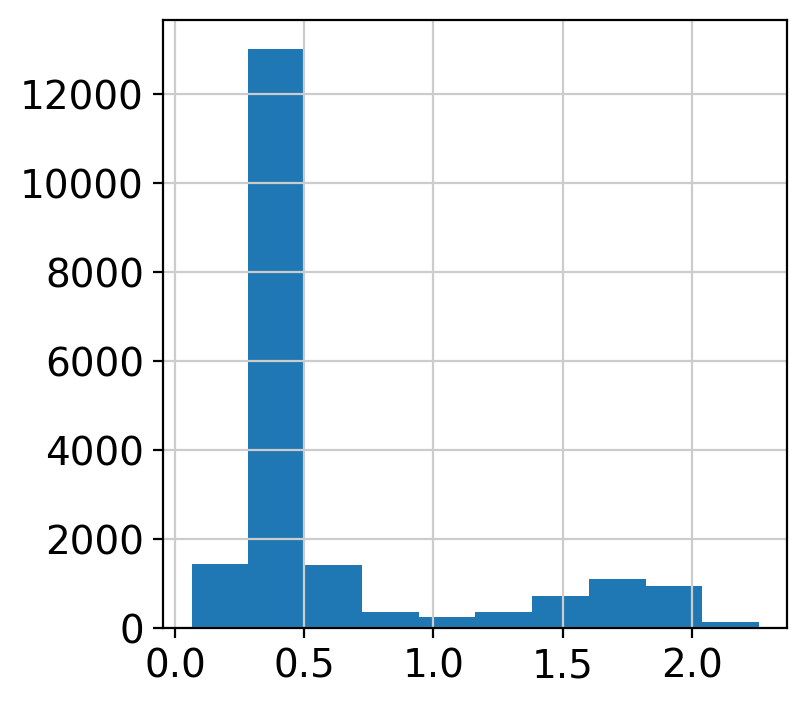

In [18]:
scjp.is_cycling(merged,cc_genes= mouse_cc_genes,cut_off=0.6)

## Merge predicted doublets with scrublet doublets

In [19]:
ndata = merged

In [20]:
scrublet_score_cutoff = 0.7

c1 = ndata.obs['doublet_scores'] > scrublet_score_cutoff
c2 = np.array(ndata.obs['predicted_doublets'])

ndata.obs['scrublet_doublets'] = c1 | c2

# Annotations

In [21]:
ndata

AnnData object with n_obs × n_vars = 19663 × 31053 
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'sort', 'method', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'Cycle_score', 'isCycle', 'scrublet_doublets'
    var: 'GeneName', 'GeneID'

In [22]:
scjp.sc_process(ndata,pid='fpnul')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:01.14)
computing neighbors
    using 'X_pca' with n_pcs = 50


/home/ubuntu/.local/lib/python3.6/site-packages/umap/rp_tree.py:450: NumbaWarning:


Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /home/ubuntu/.local/lib/python3.6/site-packages/umap/rp_tree.py (457)

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee type: recursive(type(CPUDispatcher(<function make_euclidean_tree at 0x7

    finished (0:00:07.96) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:19.10) --> added
    'X_umap', UMAP coordinates (adata.obsm)
running Leiden clustering
    finished (0:00:06.86) --> found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


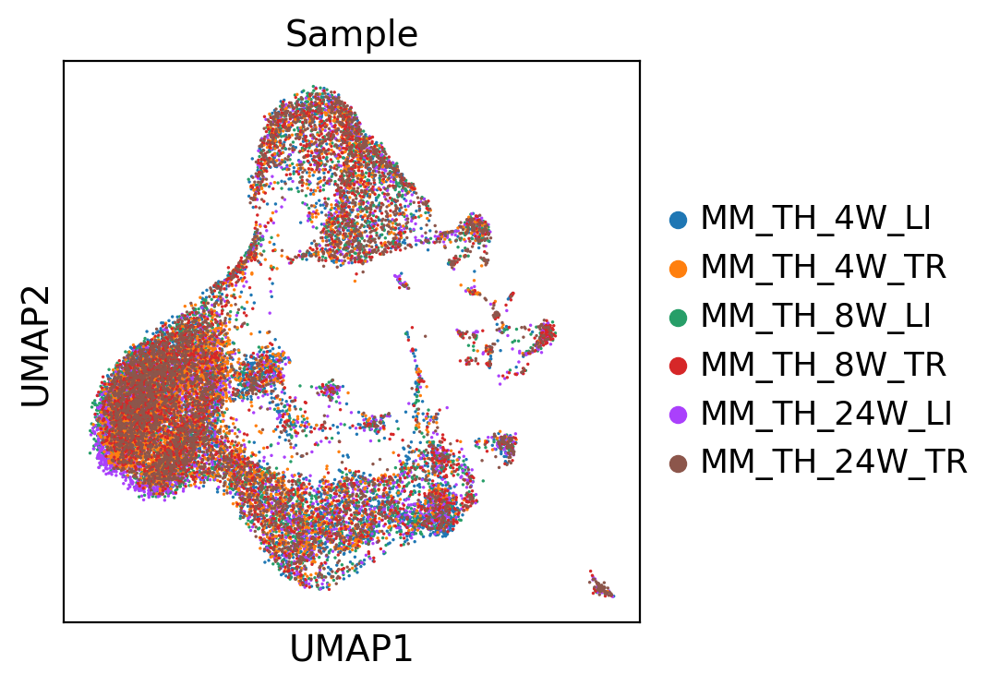

In [23]:
scjp.us(ndata,'Sample')

## Load human data

In [26]:
human = sc.read('HTA07.A01.v02.fig1_data')

Only considering the two last: ['.v02', '.fig1_data'].


In [27]:
hom = pd.read_table('D03_HOM_MouseHumanSequence.rpt.txt')

In [28]:
c_m = hom['NCBI Taxon ID']==10090
c_h = hom['NCBI Taxon ID']==9606

In [29]:
MtH = {}
HtM = {}
for HomID in sorted(set(hom['HomoloGene ID'])):
    c1 = hom['HomoloGene ID']==HomID
    try: hum = np.array(hom[c1&c_h]['Symbol'])[0]
    except: continue
    try: mus = np.array(hom[c1&c_m]['Symbol'])[0]
    except: continue
    MtH[mus] = hum 
    HtM[hum] = mus

In [30]:
def mouse_to_human(x):
    if x in MtH:
        return MtH[x]
    else:
        return x.upper()

In [31]:
mouse = sc.AnnData(ndata.raw.X,var = ndata.raw.var, obs = ndata.obs)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [32]:
mouse.var_names = np.array([mouse_to_human(x) for x in mouse.var_names])

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [33]:
mouse.raw = mouse

In [34]:
human_new, mouse_new = scjp.model.get_common_var_raw(human,mouse)

calculating a...
calculating b...


In [35]:
mouse_new

AnnData object with n_obs × n_vars = 19663 × 17034 
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'sort', 'method', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'Cycle_score', 'isCycle', 'scrublet_doublets', 'leiden'

In [36]:
human_new

AnnData object with n_obs × n_vars = 259265 × 17034 
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'sort', 'method', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'source', 'birth', 'batch', 'bbk', 'Order', 'File', 'Age', 'Enzyme', 'Source', 'Stage', 'Stage2', 'scrublet_doublets', 'is_Fig1', 'is_file_Fig1', 'true_doublets', 'missed_doublets_scbl', 'missed_doublets_jp', 'anno_doublet_4_scores', 'anno_doublet_5_scores', 'anno_doublet_6_scores', 'anno_doublet_7_scores', 'anno_doublet_8_scores', 'anno_doublet_T_scores', 'dbl_jp_method', 'broad_doublets', 'anno_pred', 'anno_fig1_detailed.replaced.1', 'anno_predict_B.replaced.1', 'Cycle_score', 'isCycle', 'anno_predict_fig1.replaced.1', 'anno_fig1_detailed.replaced.2', 'anno_fig1_detailed', 'anno_predict_B.replaced.2', 'anno_predict_B', 'anno_predict_fig1.replaced.2', 'anno_predict_fig1', 'anno_final_v1', 'anno_final_v2_epi', 'Anno_level_1', 'Anno_level_2', 'Anno_level_3', 'Anno_level_4', 'Anno_level_5', 'Anno

In [37]:
arr = np.array(human_new.obs['anno_final_v1'])
arr[arr=='B_mature'] = 'B_naive'
human_new.obs['anno_final_v1'] = arr

creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...
updating lr to adata...


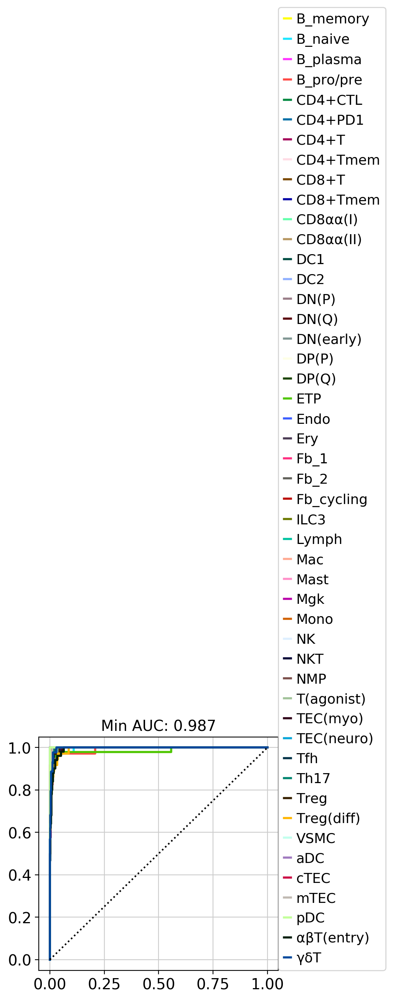

In [38]:
lr_common = scjp.model.transfer_annotation_jp(human_new,'anno_final_v1',mouse_new,'anno_pred',raw=False)

In [39]:
ndata.obs['anno_pred'] = lr_common.predict(mouse_new.X)

... storing 'anno_pred' as categorical


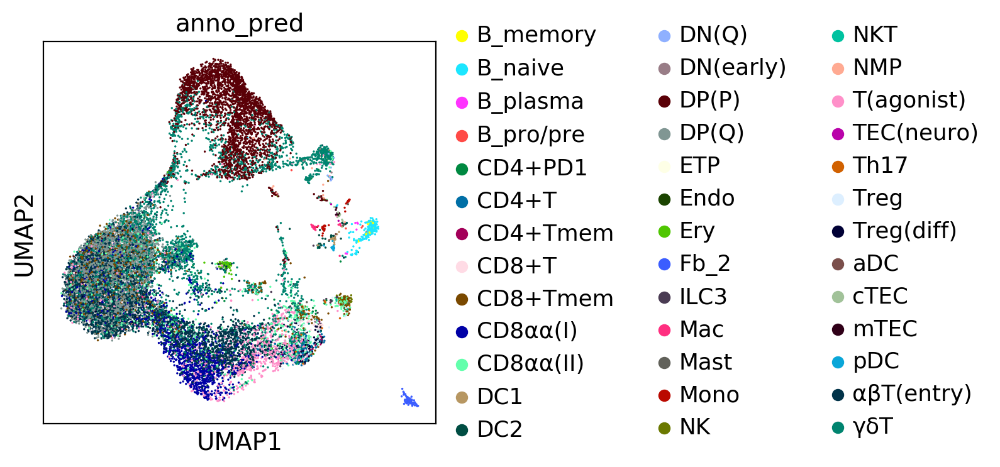

In [40]:
scjp.us(ndata,'anno_pred')

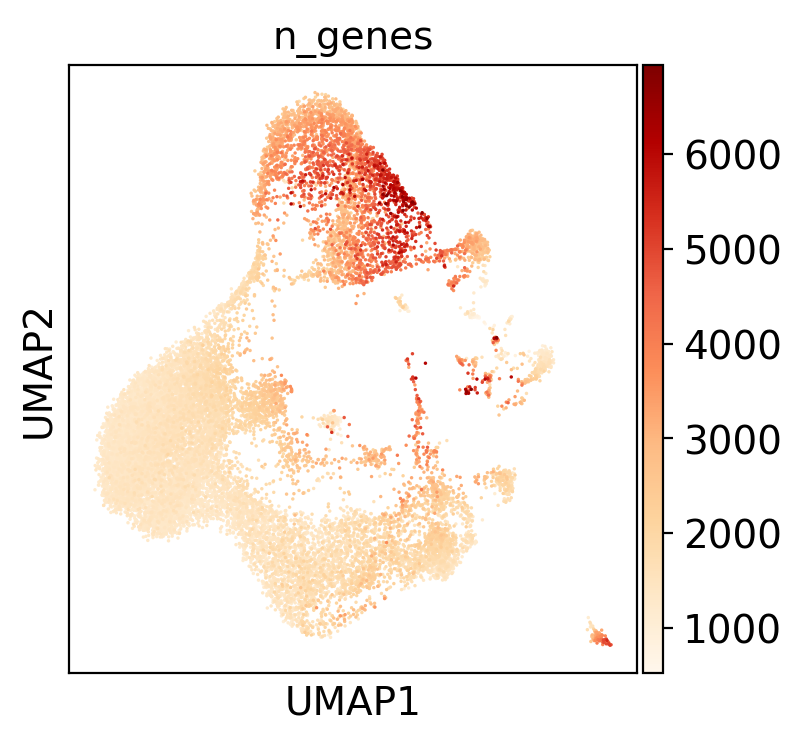

In [41]:
scjp.us(ndata,'n_genes')

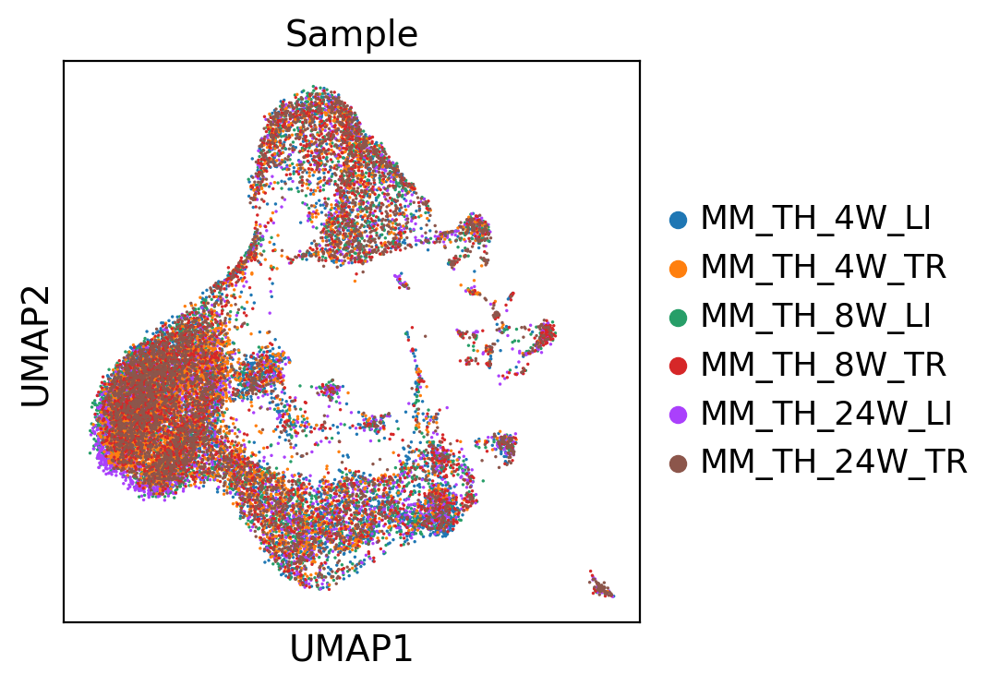

In [42]:
scjp.us(ndata,'Sample')

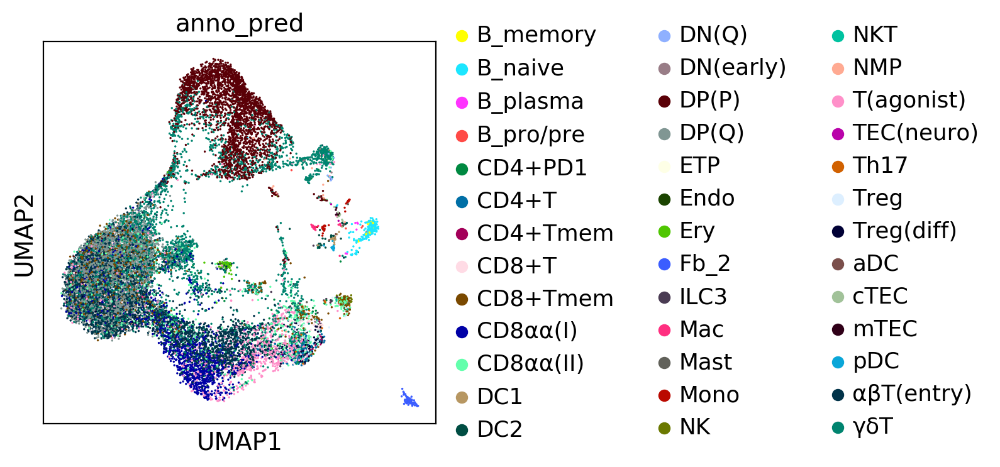

In [43]:
scjp.us(ndata,'anno_pred')

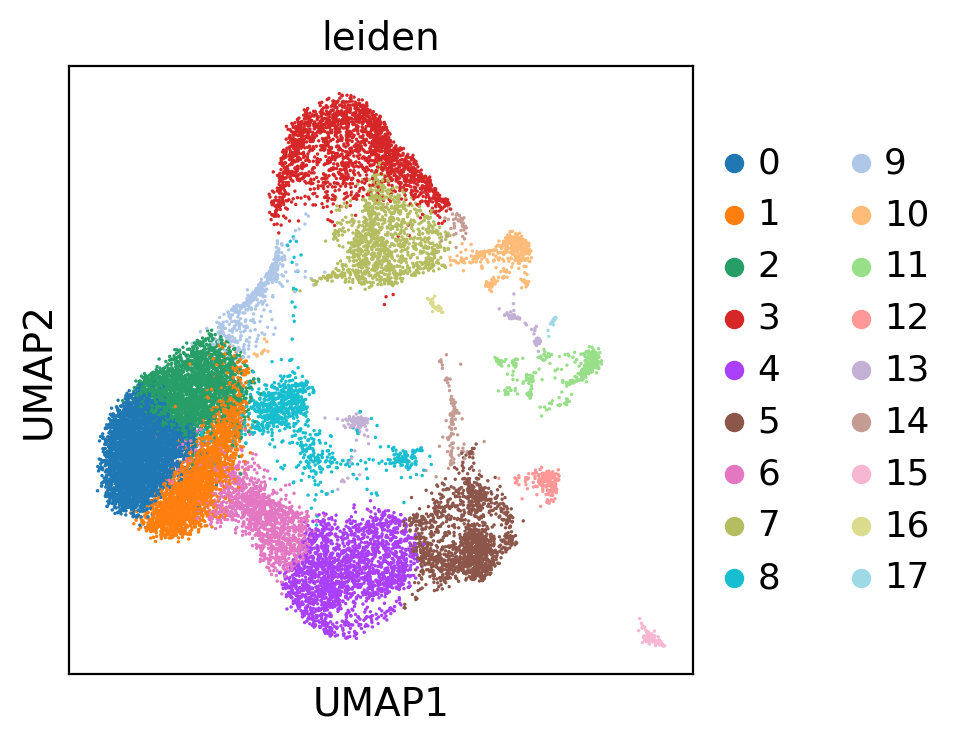

In [44]:
scjp.us(ndata,'leiden')

In [46]:
cvt = {'7':'DP(P)','3':'DP(P)','10':'DN','13':'nonT','11':'nonT',
 '14':'SP_cycling','5':'SP','4':'entry2','6':'entry1','0':'DP(Q)','1':'DP(Q)','2':'DP(Q)',
 '9':'DP(P)','12':'NKT','8':'T_unknown','15':'Fb','16':'unknwon','17':'nonT'}

In [47]:
ndata.obs['anno_level_1'] = [cvt[x] for x in ndata.obs['leiden']]

In [48]:
ndata.raw.var_names

Index(['Gnai3', 'Pbsn', 'Cdc45', 'H19', 'Scml2', 'Apoh', 'Narf', 'Cav2',
       'Klf6', 'Scmh1',
       ...
       'AC109204.1', 'AC097366.1', 'AC165344.1', 'AC154242.1', 'AC125199.4',
       'CT030713.2', 'AC150035.3', 'AC164314.2', 'AC131339.4', 'AC135964.2'],
      dtype='object', name='index', length=31053)

In [49]:
nT = scjp.get_subset(ndata,ndata.obs['leiden'].isin('11,13,17,16'.split(',')),cc_genes=mouse_cc_genes)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.23)


In [50]:
scjp.sc_process(nT,pid = 'nul',n_pcs=10)

computing neighbors
    using 'X_pca' with n_pcs = 10


/home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py:349: NumbaWarning:


Compilation is falling back to object mode WITH looplifting enabled because Function "fuzzy_simplicial_set" failed type inference due to: Untyped global name 'nearest_neighbors': cannot determine Numba type of <class 'function'>

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py", line 467:
def fuzzy_simplicial_set(
    <source elided>
    if knn_indices is None or knn_dists is None:
        knn_indices, knn_dists, _ = nearest_neighbors(
        ^


/home/ubuntu/.local/lib/python3.6/site-packages/numba/compiler.py:725: NumbaWarning:

Function "fuzzy_simplicial_set" was compiled in object mode without forceobj=True.

File "../../home/ubuntu/.local/lib/python3.6/site-packages/umap/umap_.py", line 350:
@numba.jit()
def fuzzy_simplicial_set(
^


/home/ubuntu/.local/lib/python3.6/site-packages/numba/compiler.py:734: NumbaDeprecationWarning:


Fall-back from the nopython compilation path

    finished (0:00:01.51) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 10
    finished (0:00:01.16) --> added
    'X_umap', UMAP coordinates (adata.obsm)
running Leiden clustering
    finished (0:00:00.03) --> found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


... storing 'anno_level_1' as categorical


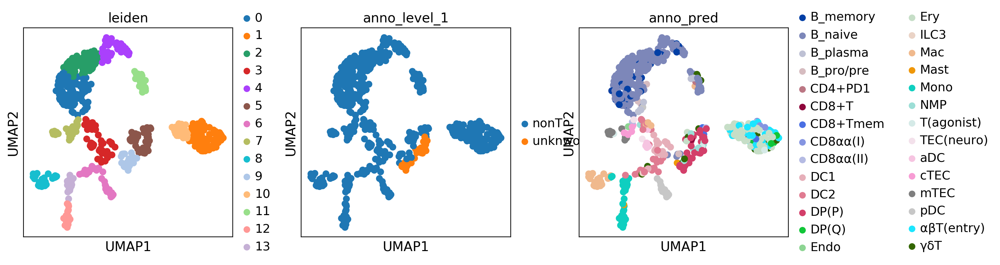

In [51]:
scjp.us(nT,'leiden,anno_level_1,anno_pred'.split(','))

In [52]:
print(sorted(set(nT.obs['leiden'])))

['0', '1', '10', '11', '12', '13', '2', '3', '4', '5', '6', '7', '8', '9']


In [53]:
cvt = {'0':'B', '1':'Ery', '10':'Ery', '11':'B-T_doublet', '12':'Mono','13':'Mono', '2':'B', '3':'DC1', '4':'B', '5':'T_unknown', '6':'DC2', '7':'TEC', '8':'Mac', '9':'T_unknown'}

In [54]:
nT.obs['anno_level_2'] = [cvt[x] for x in nT.obs['leiden']]

In [55]:
arr = np.array(nT.obs['anno_level_2'],dtype=object)
arr[nT.obs['anno_pred']=='pDC'] = 'pDC'
nT.obs['anno_level_2'] = arr

In [56]:
scjp.model.update_label(nT,'anno_level_2',ndata,'anno_level_1','anno_level_2')

... storing 'anno_level_1' as categorical
... storing 'anno_level_2' as categorical


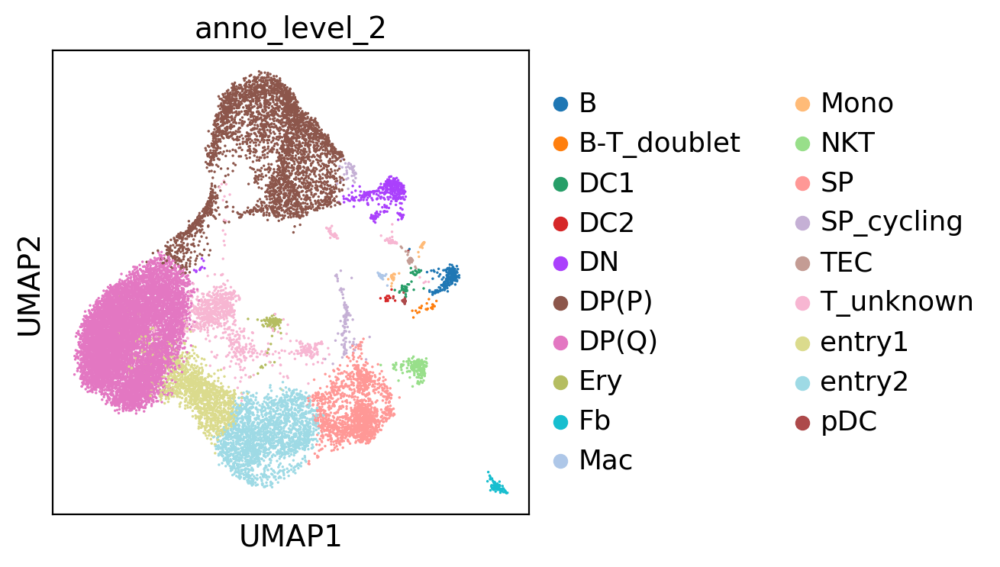

In [57]:
scjp.us(ndata,'anno_level_2')

In [58]:
T = scjp.get_subset(ndata,ndata.obs['anno_level_2'].isin('SP,SP_cycling,entry1,entry2'.split(',')),cc_genes=mouse_cc_genes)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.55)


In [59]:
scjp.sc_process(T,pid='nul',n_pcs=30)

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished (0:00:00.58) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 30
    finished (0:00:10.86) --> added
    'X_umap', UMAP coordinates (adata.obsm)
running Leiden clustering
    finished (0:00:00.78) --> found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


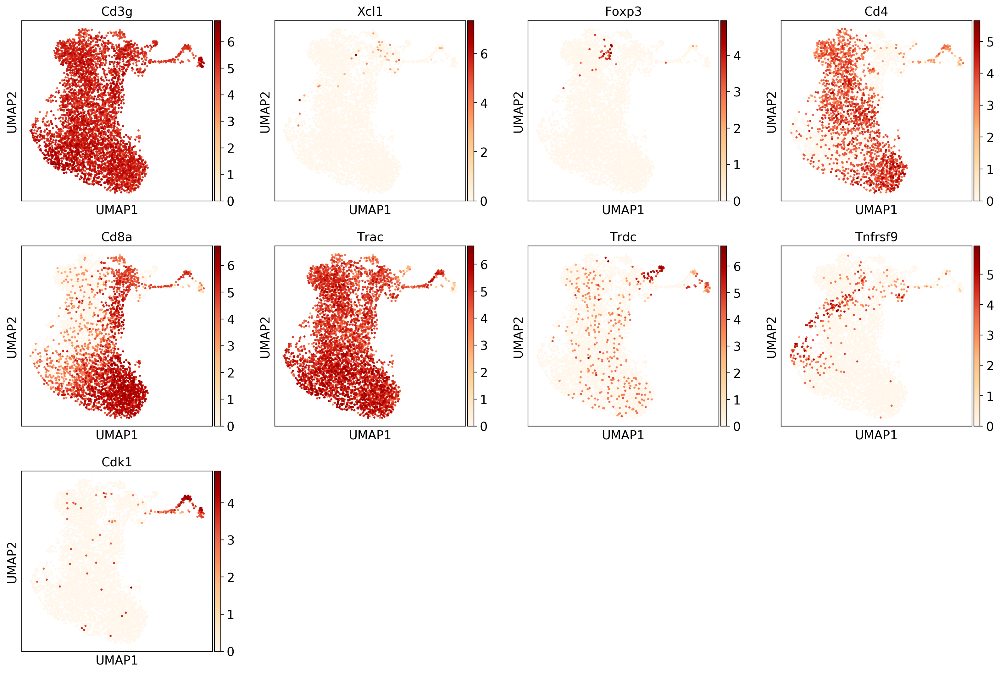

In [60]:
scjp.us(T,'Cd3g,Xcl1,Foxp3,Cd4,Cd8a,Trac,Trdc,Tnfrsf9,Cdk1'.split(','))

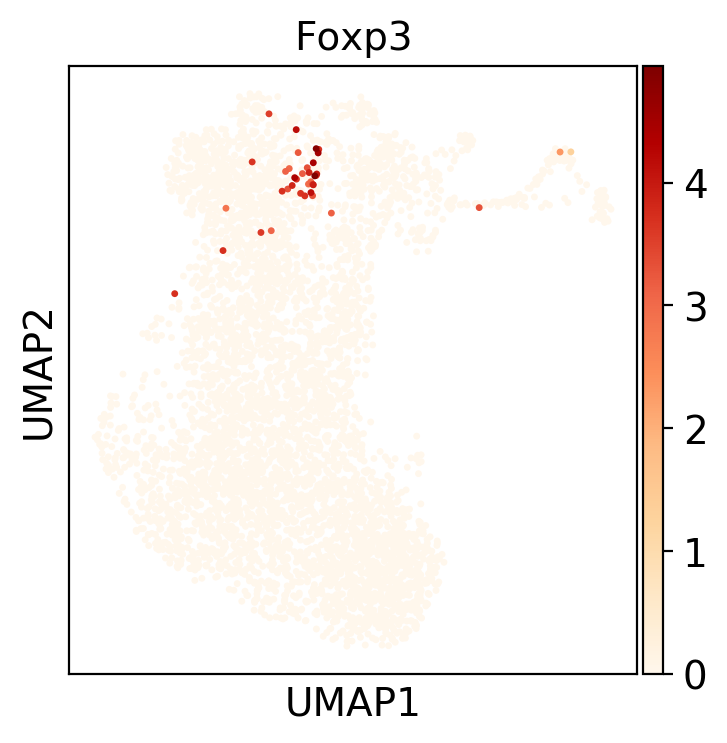

In [61]:
scjp.us(T,'Foxp3'.split(','))

In [62]:
sc.tl.leiden(T,resolution=2)

running Leiden clustering
    finished (0:00:01.68) --> found 22 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


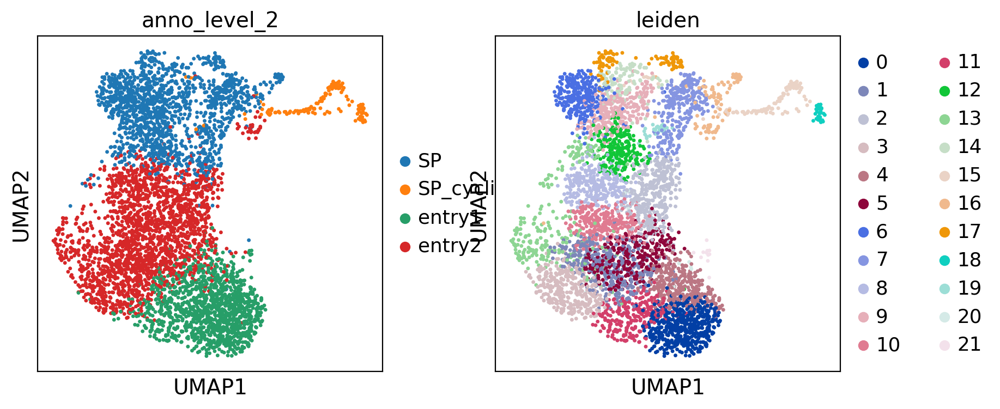

In [63]:
scjp.us(T,'anno_level_2,leiden'.split(','))

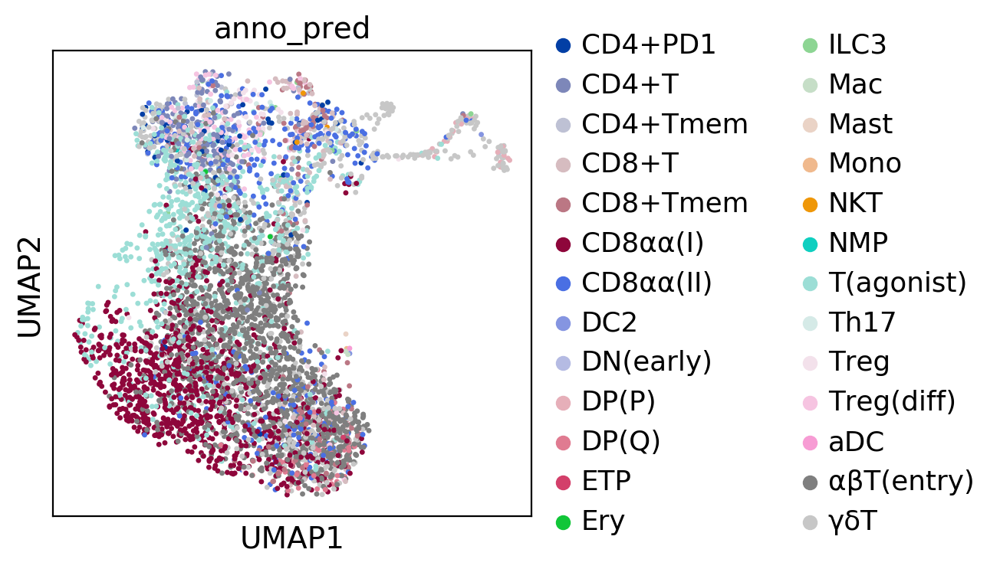

In [64]:
scjp.us(T,'anno_pred'.split(','))

In [65]:
print(sorted(set(T.obs['leiden'])))

['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '3', '4', '5', '6', '7', '8', '9']


In [67]:
sc.tl.leiden(ndata,resolution=6.0)

running Leiden clustering
    finished (0:00:15.32) --> found 103 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


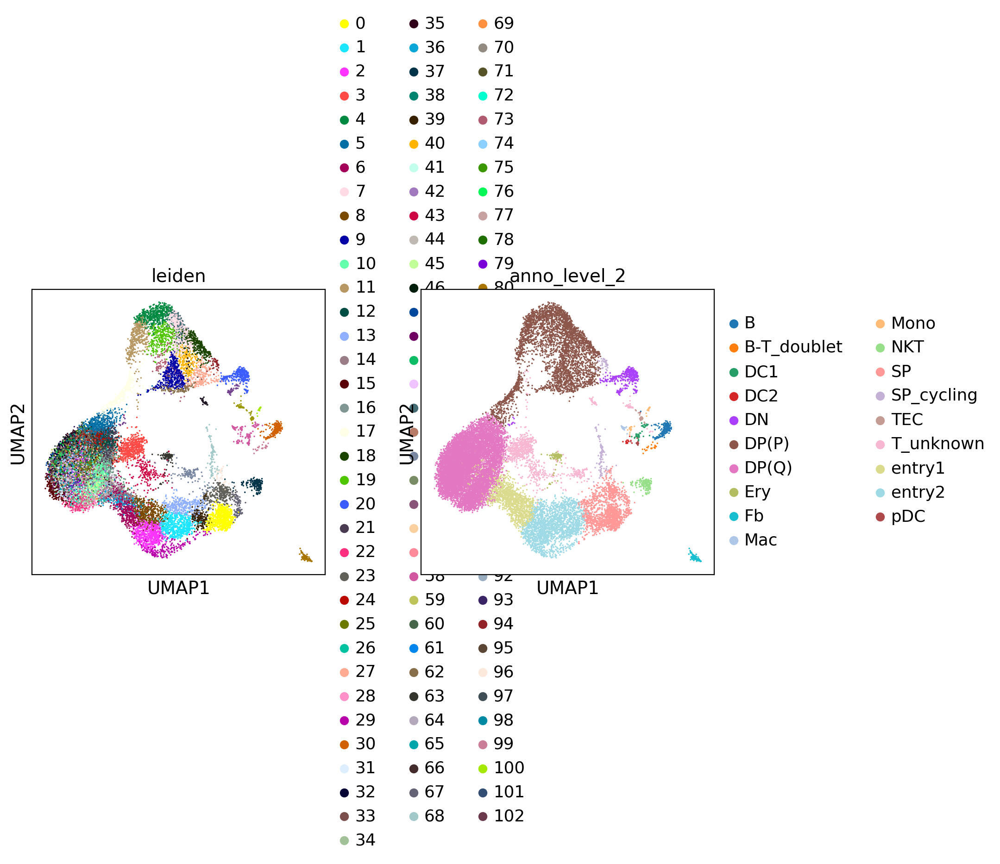

In [68]:
scjp.us(ndata,'leiden,anno_level_2'.split(','))

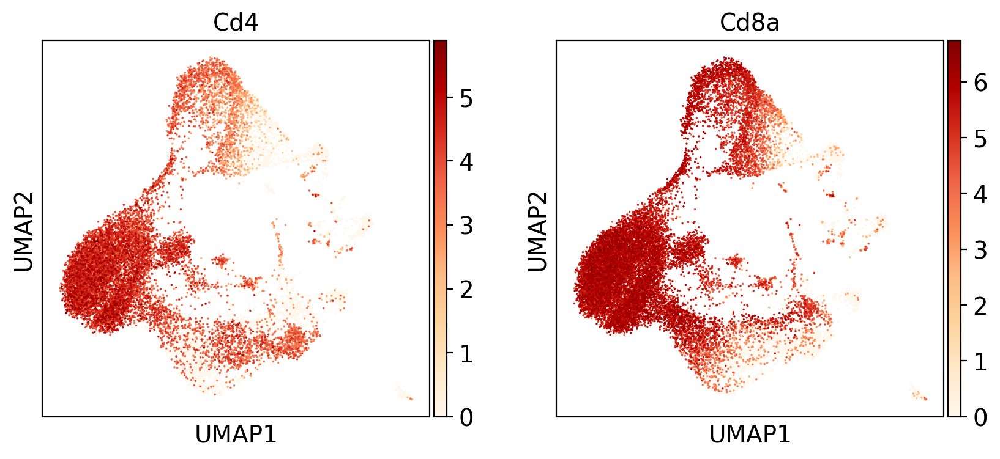

In [69]:
scjp.us(ndata,'Cd4,Cd8a'.split(','))

In [70]:
scjp.model.update_label(ndata,'leiden',T,'leiden','leiden_2')

... storing 'leiden_2' as categorical


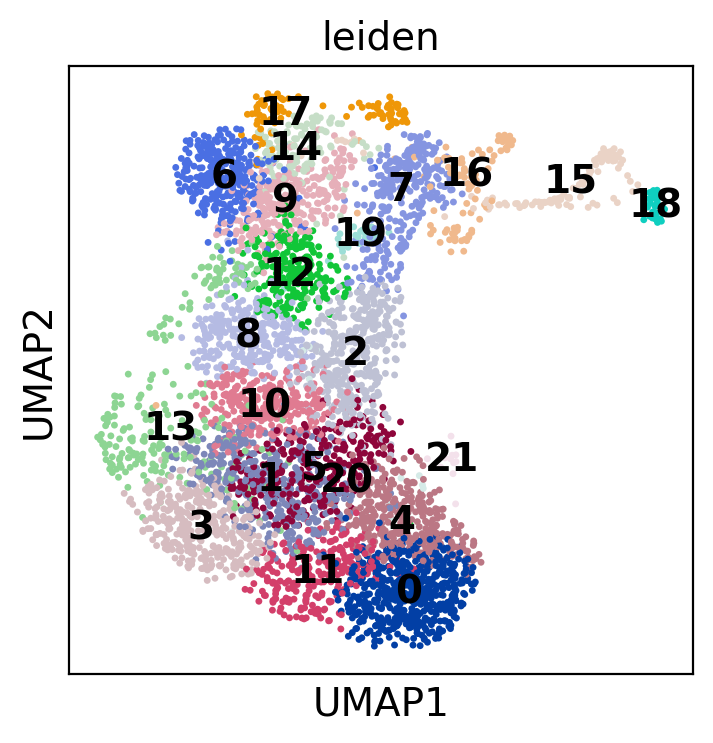

In [71]:
scjp.us(T,'leiden',legend_loc='on data')

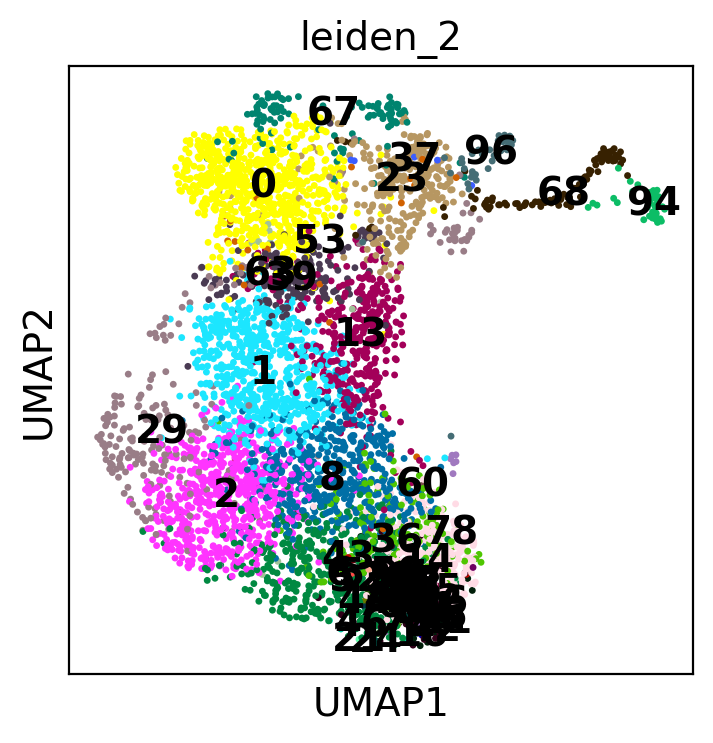

In [72]:
scjp.us(T,'leiden_2',legend_loc='on data')

In [73]:
cvt = {'29':'T_Tnfrsf9','96':'T_gd_1','94':'T_gd_2','0':'T_CD4','1':'T_CD4','13':'T_CD8','23':'T_CD8'}

In [74]:
T.obs['anno_level_3'] = [cvt[x] if x in cvt else a for x,a in zip(T.obs['leiden_2'],T.obs['anno_level_2'])]

... storing 'anno_level_3' as categorical


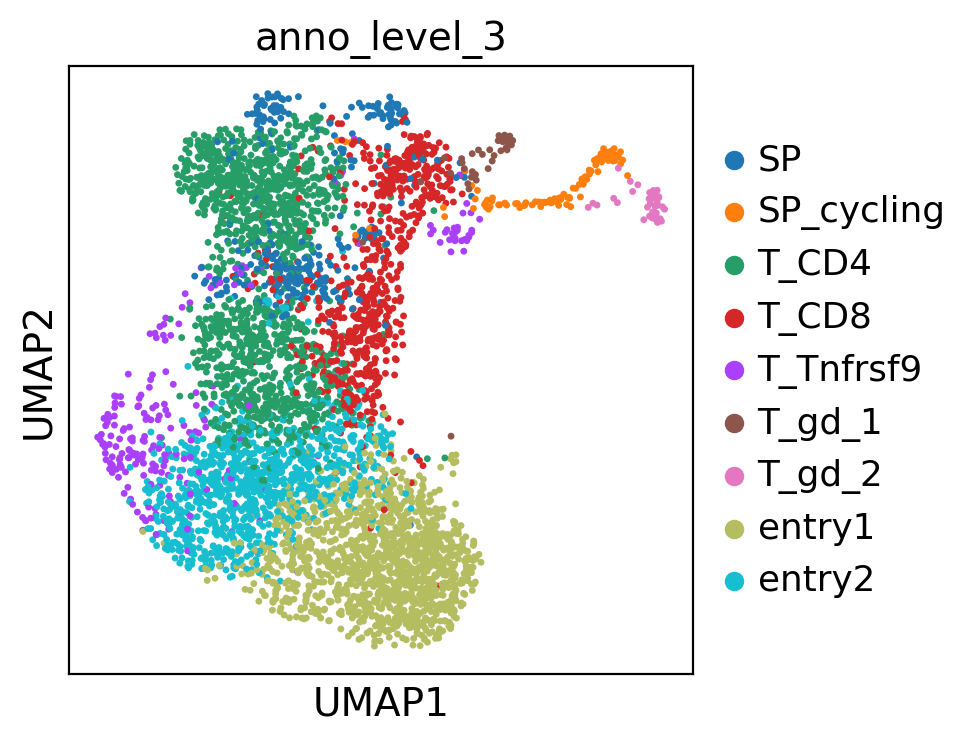

In [75]:
scjp.us(T,'anno_level_3')

creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...
updating lr to adata...


LogisticRegression(C=0.2, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

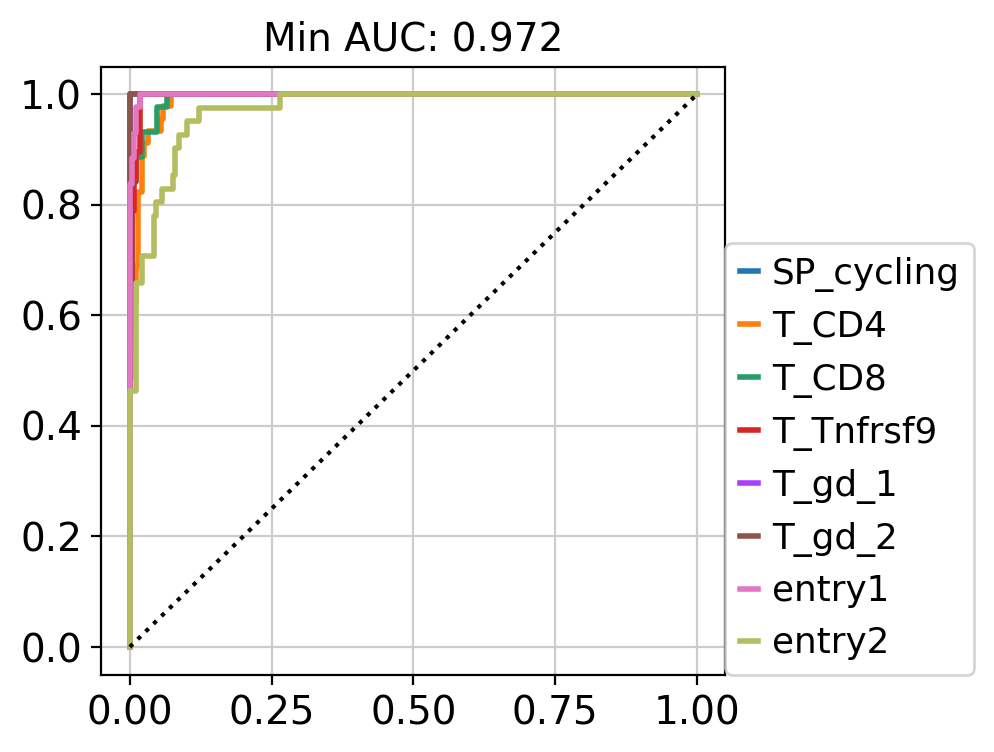

In [76]:
scjp.model.transfer_annotation_jp(T,'anno_level_3',T,'anno_level_4',exclude=['SP'])

... storing 'anno_level_4' as categorical


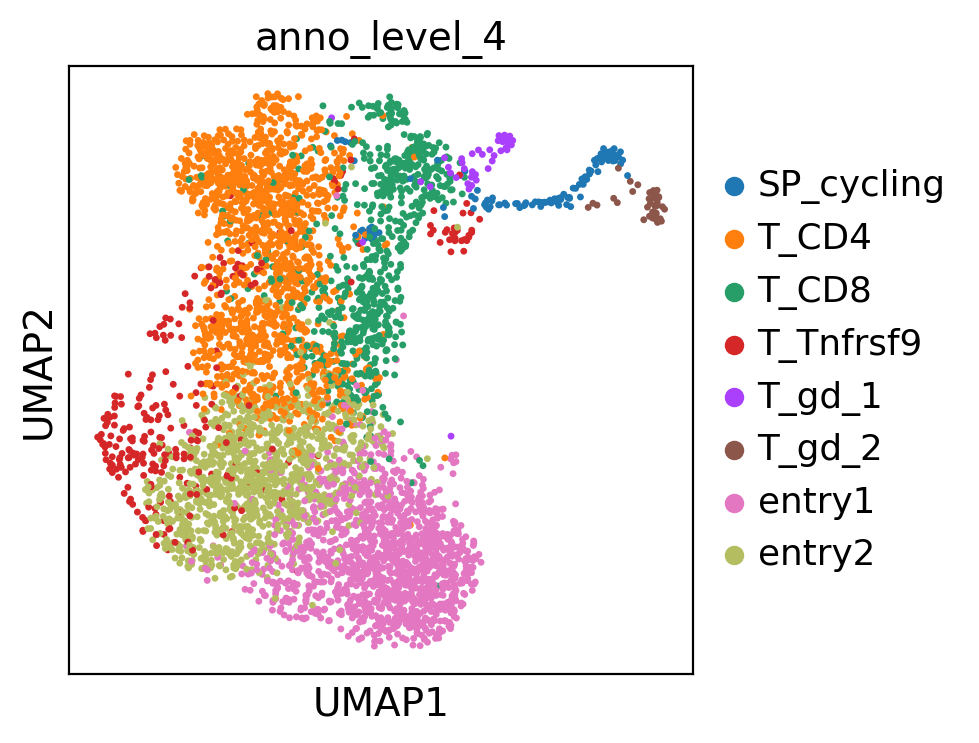

In [77]:
scjp.us(T,'anno_level_4')

creating lr model...
making lr prediction...
updating lr to adata...


LogisticRegression(C=0.2, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

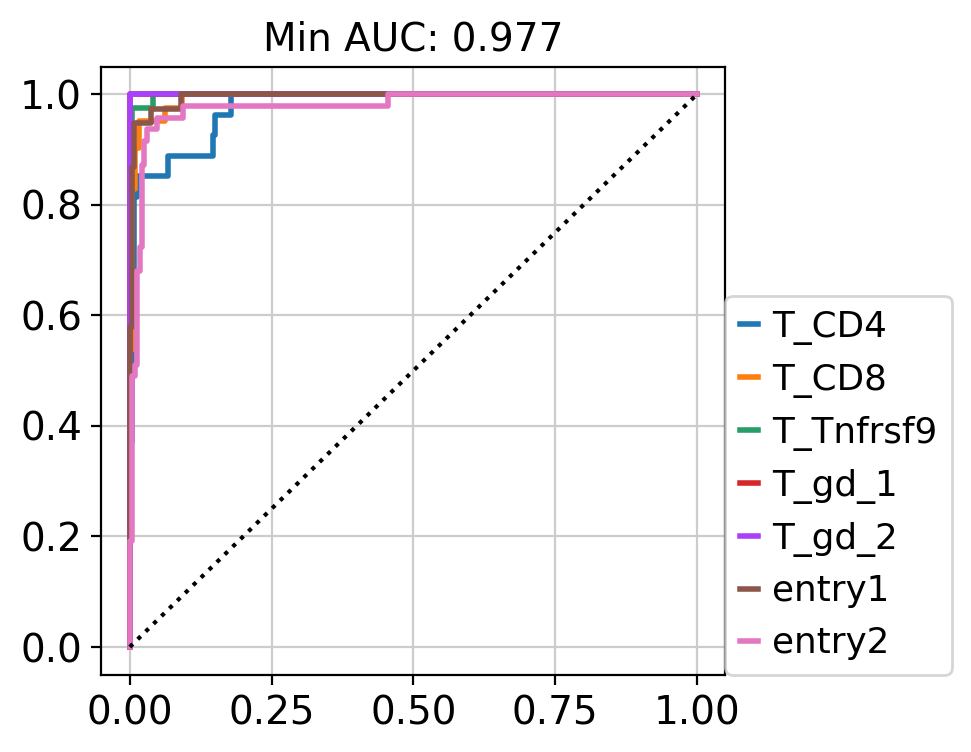

In [78]:
scjp.model.transfer_annotation_jp(T,'anno_level_3',T,'anno_level_5',exclude=['SP','SP_cycling'])

In [79]:
scjp.model.update_label(T,'anno_level_4',ndata,'anno_level_2','anno_level_4')

In [80]:
scjp.model.update_label(T,'anno_level_5',ndata,'anno_level_4','anno_level_5')

... storing 'anno_level_4' as categorical
... storing 'anno_level_5' as categorical


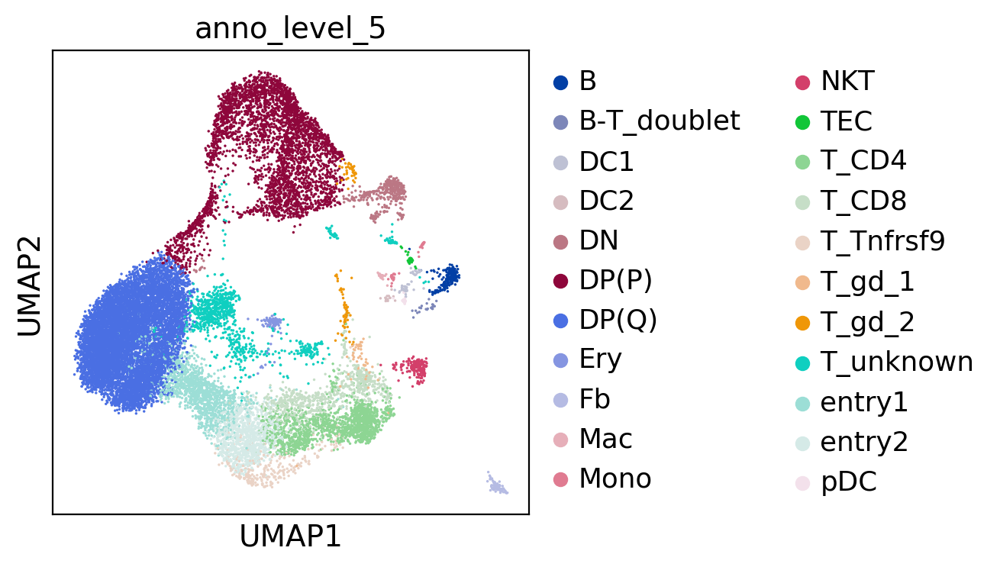

In [81]:
scjp.us(ndata,'anno_level_5')

In [82]:
uT = scjp.get_subset(ndata,ndata.obs['anno_level_5'].isin('T_unknown'.split(',')),cc_genes=mouse_cc_genes)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.17)


In [83]:
scjp.sc_process(uT,pid='nul',n_pcs=15)

computing neighbors
    using 'X_pca' with n_pcs = 15
    finished (0:00:00.05) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 15
    finished (0:00:01.98) --> added
    'X_umap', UMAP coordinates (adata.obsm)
running Leiden clustering
    finished (0:00:00.12) --> found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


In [84]:
sc.tl.leiden(uT,resolution=.3)

running Leiden clustering
    finished (0:00:00.10) --> found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


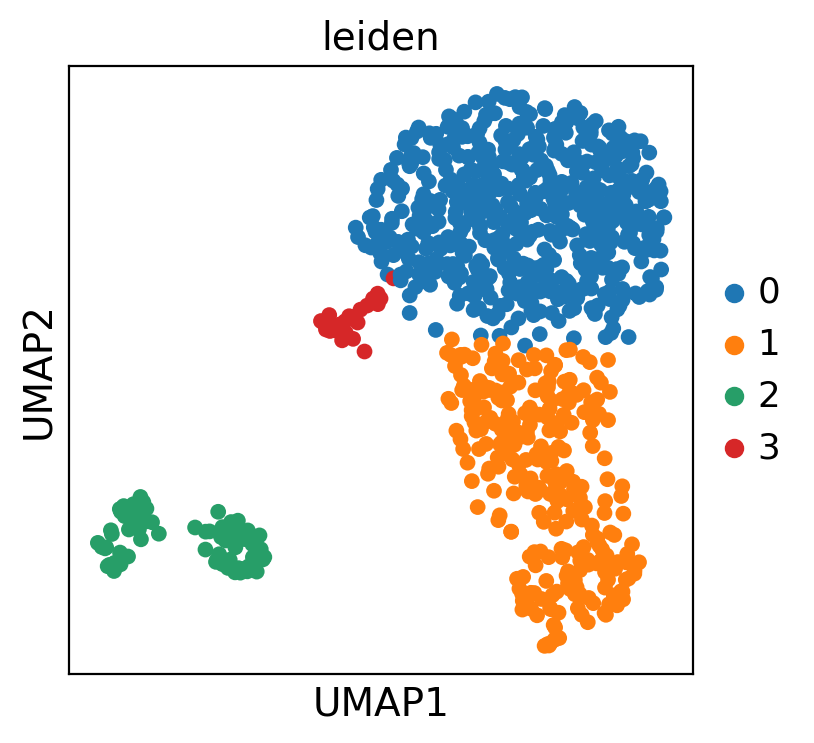

In [85]:
scjp.us(uT,'leiden')

In [86]:
mks = scjp.markers.find_markers(uT,'leiden')

/mnt/thymus_atlas/scjp/markers.py:166: RuntimeWarning:

invalid value encountered in true_divide



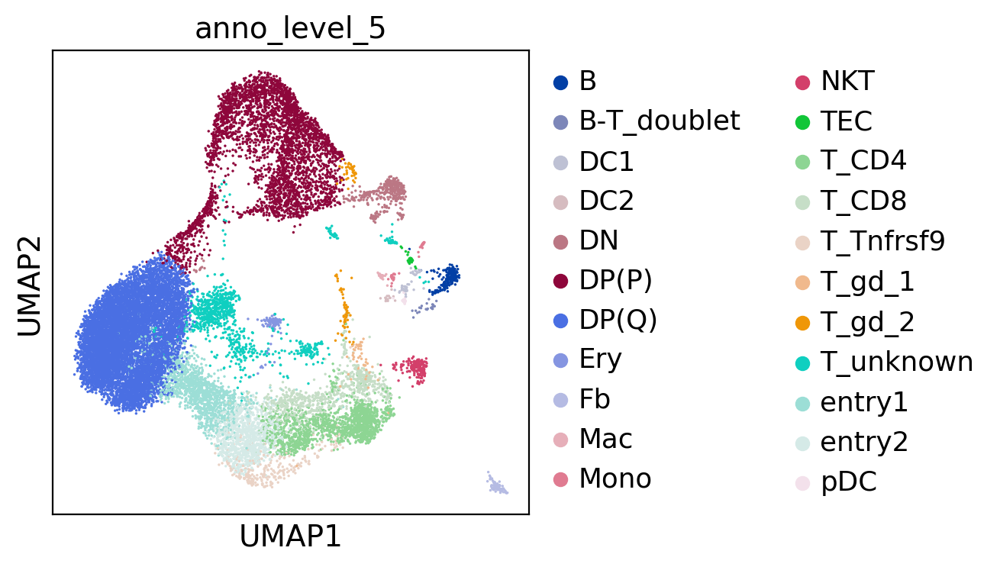

In [87]:
scjp.us(ndata,'anno_level_5')

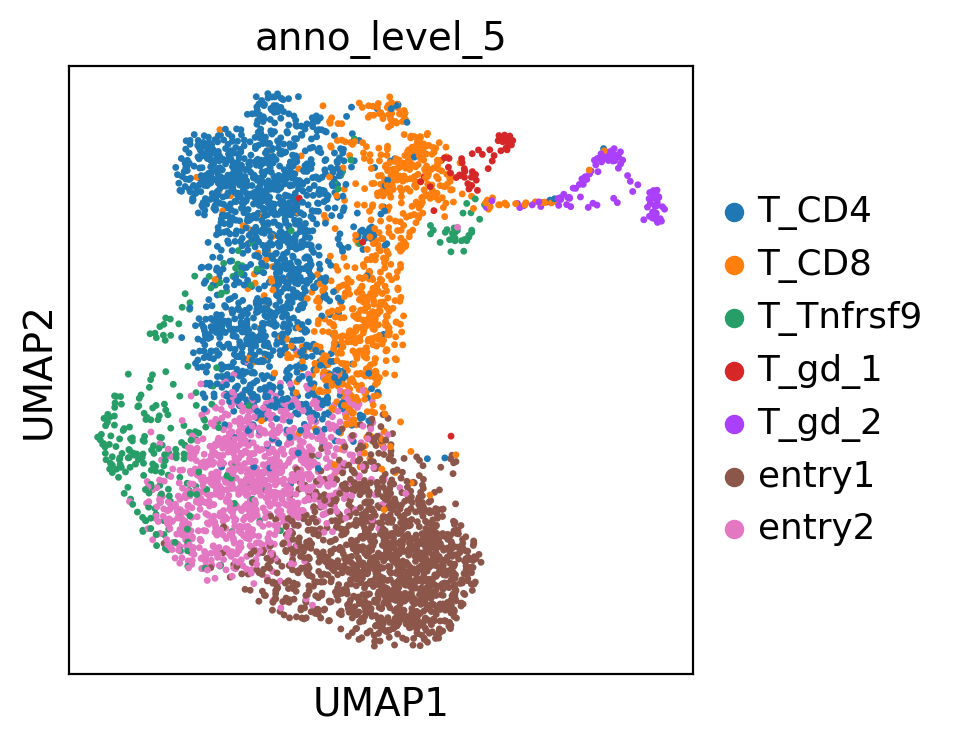

In [181]:
scjp.us(T,'anno_level_5')

In [194]:
sc.tl.leiden(T,resolution=3.0)

running Leiden clustering
    finished (0:00:01.65) --> found 32 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


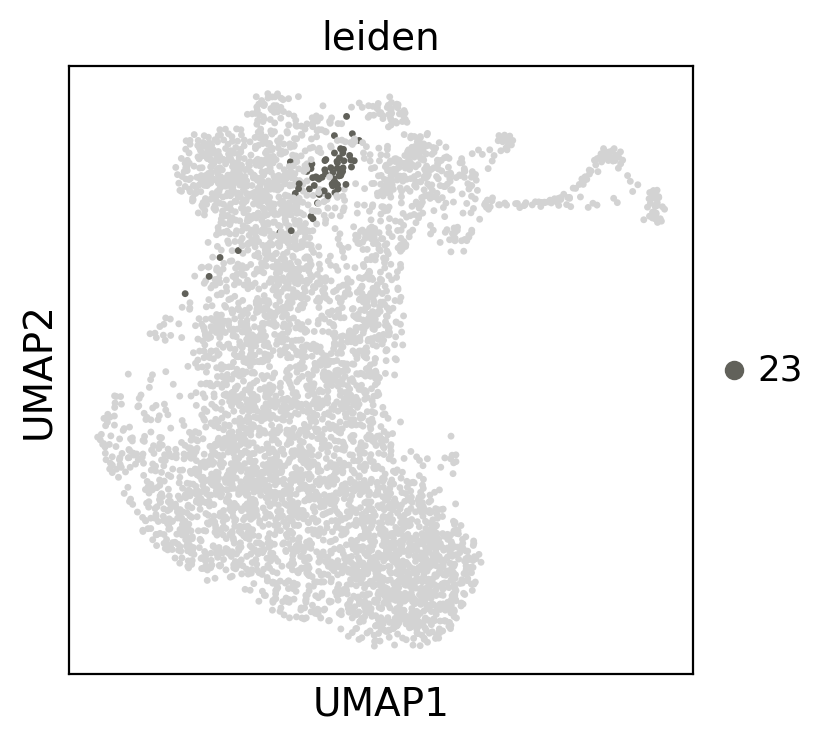

In [198]:
scjp.us(T,'leiden',groups=['23'])

In [199]:
arr = np.array(T.obs['anno_level_5'],dtype=object)
arr[T.obs['leiden']=='23'] = 'Treg'
T.obs['anno_level_6'] = arr

In [201]:
model.update_label(T,'anno_level_6',ndata,'anno_level_5','anno_level_6')

In [204]:
ndata_subset = ndata[ndata.obs['anno_level_6']!='T_unknown'].copy()

... storing 'anno_level_6' as categorical


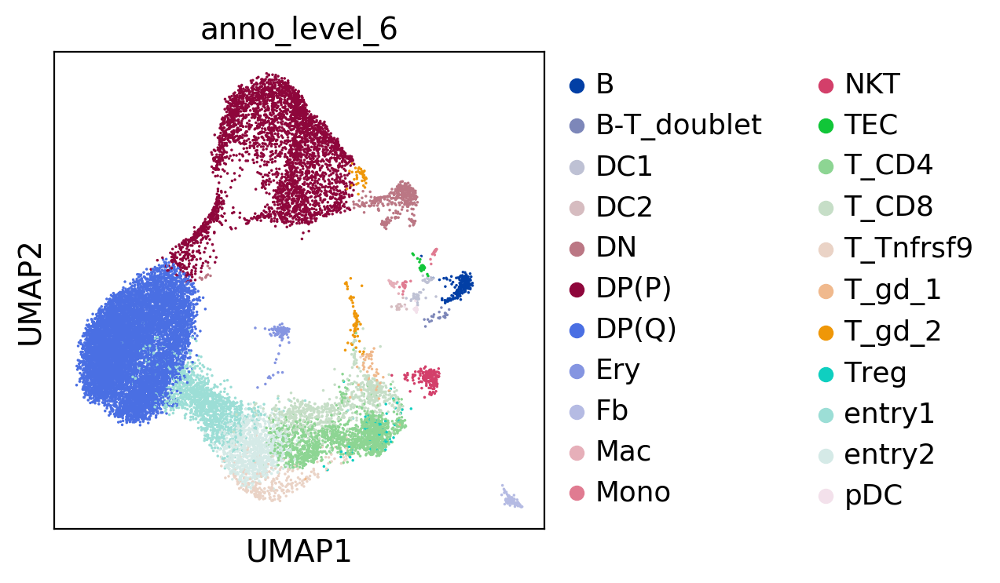

In [205]:
scjp.us(ndata_subset,'anno_level_6')

In [206]:
scjp.write(ndata_subset,version,'jp_mouse_unknown_removed')

Only considering the two last: ['.A02', '.jp_mouse_unknown_removed'].
HTA08_v01_A02_jp_mouse_unknown_removed = 'HTA08.v01.A02.jp_mouse_unknown_removed'


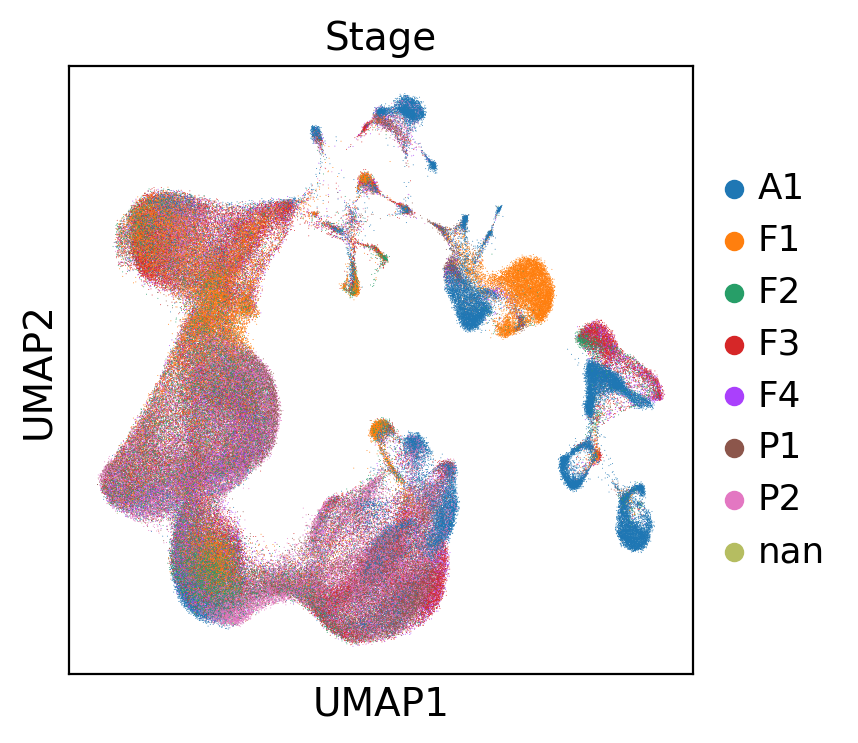

In [88]:
scjp.us(human,'Stage')

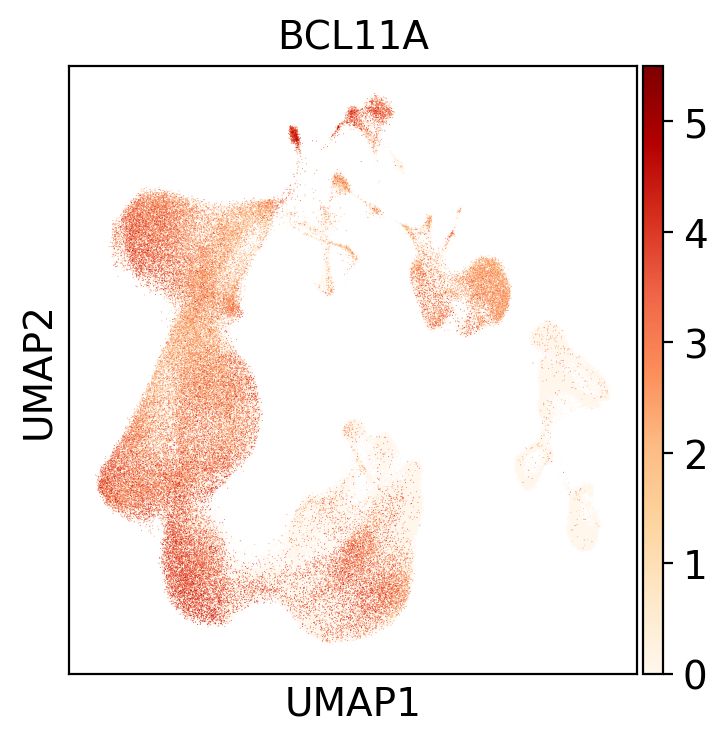

In [89]:
scjp.us(human,'BCL11A')

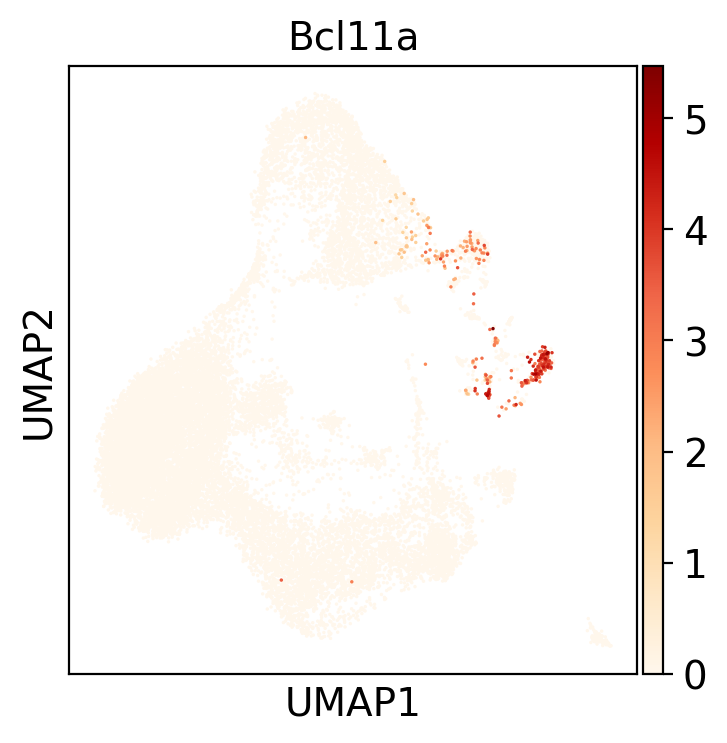

In [90]:
scjp.us(ndata,'Bcl11a')

In [92]:
scjp.write(ndata,version,'mouse_4w8w24w')

Only considering the two last: ['.A02', '.mouse_4w8w24w'].
HTA08_v01_A02_mouse_4w8w24w = 'HTA08.v01.A02.mouse_4w8w24w'


## Import thymus cell atlas dataset

In [151]:
tca = sc.read('HTA08.v01.A03.tca_mouse_annotated')

Only considering the two last: ['.A03', '.tca_mouse_annotated'].


In [118]:
tca_humanised_genenames = sc.AnnData(tca.raw.X,var = tca.raw.var, obs = tca.obs)

In [119]:
tca_humanised_genenames.var_names = np.array([mouse_to_human(x) for x in tca_humanised_genenames.var_names])

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [120]:
tca_humanised_genenames.raw = tca_humanised_genenames

In [121]:
human_new, mouse_new = scjp.model.get_common_var_raw(human,tca_humanised_genenames)

calculating a...
calculating b...


In [122]:
mouse_new

AnnData object with n_obs × n_vars = 17441 × 15888 
    obs: 'Sample', 'n_counts', 'n_genes', 'age', 'doublet_scores', 'predicted_doublets', 'name', 'Cycle_score', 'isCycle', 'scrublet_doublets', 'leiden'

In [123]:
human_new

AnnData object with n_obs × n_vars = 259265 × 15888 
    obs: 'Sample', 'n_counts', 'n_genes', 'donor', 'organ', 'sort', 'method', 'file', 'mito', 'doublet_scores', 'predicted_doublets', 'name', 'source', 'birth', 'batch', 'bbk', 'Order', 'File', 'Age', 'Enzyme', 'Source', 'Stage', 'Stage2', 'scrublet_doublets', 'is_Fig1', 'is_file_Fig1', 'true_doublets', 'missed_doublets_scbl', 'missed_doublets_jp', 'anno_doublet_4_scores', 'anno_doublet_5_scores', 'anno_doublet_6_scores', 'anno_doublet_7_scores', 'anno_doublet_8_scores', 'anno_doublet_T_scores', 'dbl_jp_method', 'broad_doublets', 'anno_pred', 'anno_fig1_detailed.replaced.1', 'anno_predict_B.replaced.1', 'Cycle_score', 'isCycle', 'anno_predict_fig1.replaced.1', 'anno_fig1_detailed.replaced.2', 'anno_fig1_detailed', 'anno_predict_B.replaced.2', 'anno_predict_B', 'anno_predict_fig1.replaced.2', 'anno_predict_fig1', 'anno_final_v1', 'anno_final_v2_epi', 'Anno_level_1', 'Anno_level_2', 'Anno_level_3', 'Anno_level_4', 'Anno_level_5', 'Anno

In [124]:
arr = np.array(human_new.obs['anno_final_v1'])
arr[arr=='B_mature'] = 'B_naive'
human_new.obs['anno_final_v1'] = arr

creating lr model...
making lr prediction...
updating lr to adata...


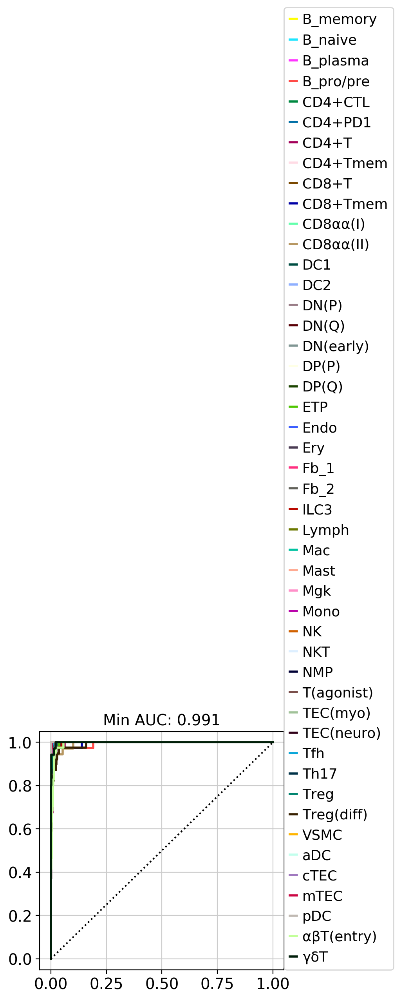

In [136]:
lr_common = scjp.model.transfer_annotation_jp(human_new,'anno_final_v1',mouse_new,'anno_pred',raw=False,exclude=['Fb_cycling'])

In [137]:
len(tca)

17441

In [138]:
len(mouse_new)

17441

In [139]:
tca.obs['anno_pred'] = lr_common.predict(mouse_new.X)

... storing 'anno_pred' as categorical


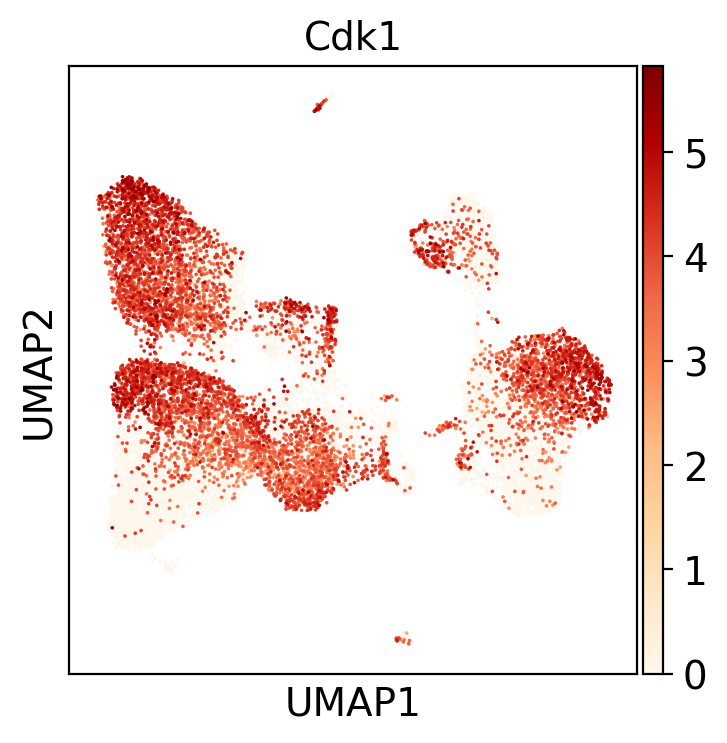

In [140]:
scjp.us(tca,'Cdk1')

## merging_mouse

In [208]:
jp_m,tca_m = model.get_common_var_raw(ndata_subset,tca)

calculating a...
calculating b...


In [209]:
ad = {}

In [210]:
ad['jp'] = jp_m
ad['tca'] = tca_m

In [606]:
merged = scjp.merge_matrix(ad)

36168
Sample
n_counts
n_genes
donor
organ
sort
method
file
mito
doublet_scores
predicted_doublets
name
Cycle_score
isCycle
scrublet_doublets
leiden
anno_pred
anno_level_1
anno_level_2
anno_level_4
anno_level_5
anno_level_6
age


In [217]:
merged.raw = merged

In [218]:
scjp.sc_process(merged,pid='fp')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:01.63)


In [219]:
scjp.bbknn_umap(merged,'name',50)

computing batch balanced neighbors
	finished (0:00:06.15) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50


/home/ubuntu/.local/lib/python3.6/site-packages/umap/spectral.py:229: UserWarning:

Embedding a total of 3 separate connected components using meta-embedding (experimental)



    finished (0:00:18.89) --> added
    'X_umap', UMAP coordinates (adata.obsm)


creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...
updating lr to adata...


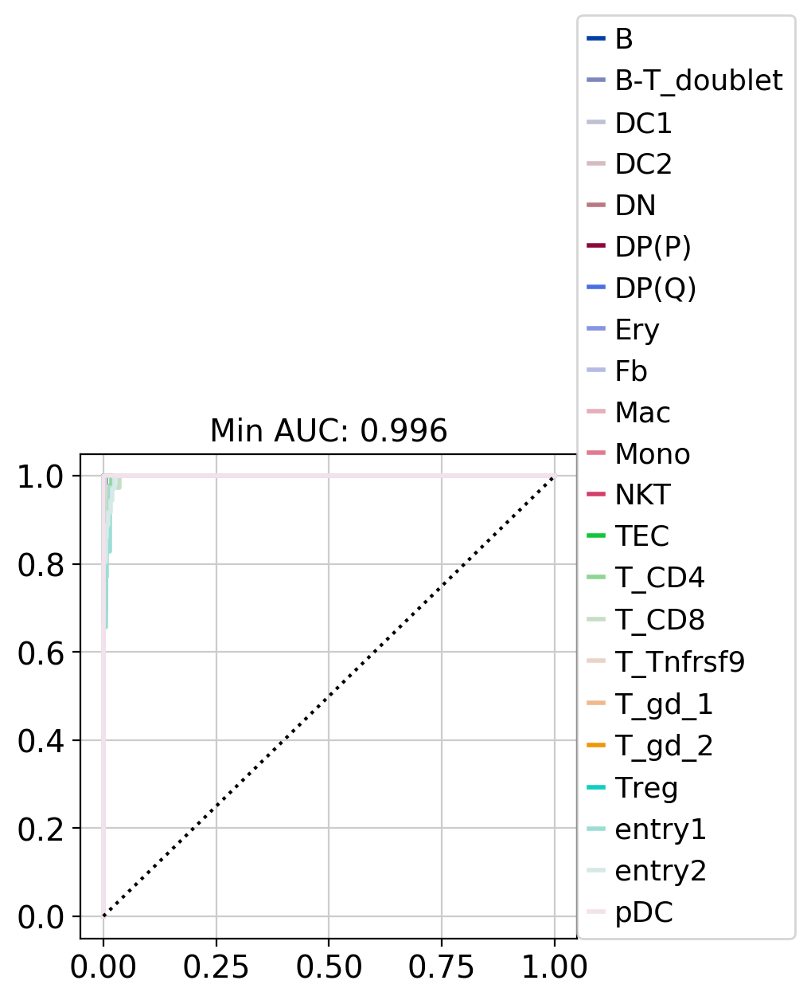

In [220]:
lr_mouse = model.transfer_annotation_jp(merged,'anno_level_6',merged,'anno_level_7',exclude=['n/a'])

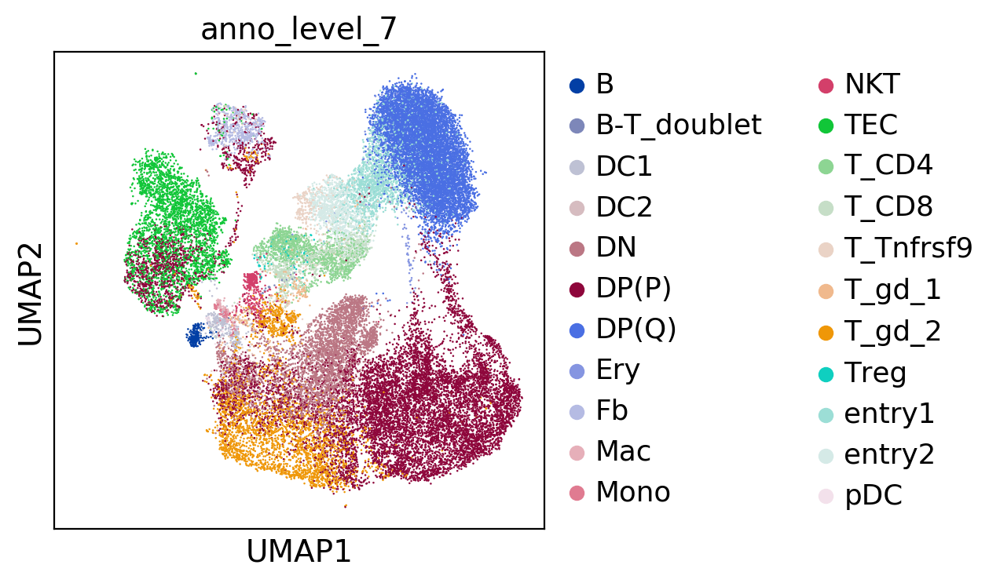

In [222]:
scjp.us(merged,'anno_level_7')

In [242]:
sc.tl.leiden(merged,resolution=0.2)

running Leiden clustering
    finished (0:00:04.03) --> found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


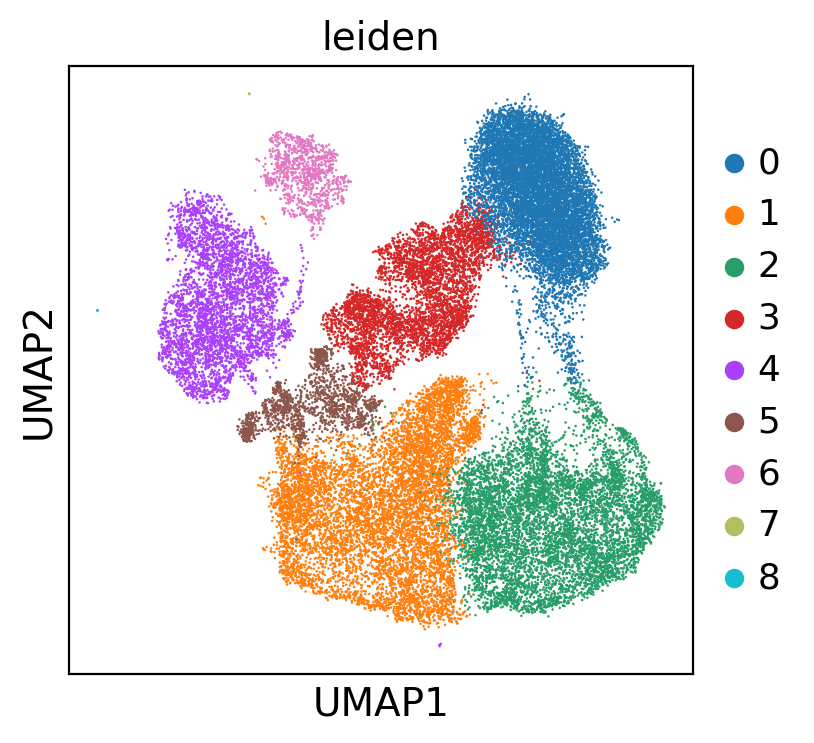

In [243]:
scjp.us(merged,'leiden')

In [249]:
bdata,X_explained = scjp.regress_iter(merged,['name'],['leiden'],'Sample')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:01.13)
computing batch balanced neighbors
	finished (0:00:23.29) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix


In [250]:
bdata.raw = sc.AnnData(merged.raw.X,var=merged.raw.var)

In [251]:
sc.tl.umap(bdata)

computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:56.16) --> added
    'X_umap', UMAP coordinates (adata.obsm)


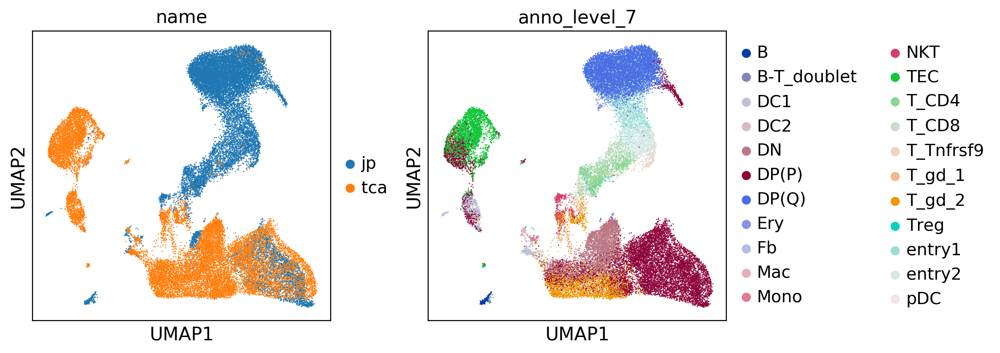

In [252]:
scjp.us(bdata,'name,anno_level_7'.split(','))

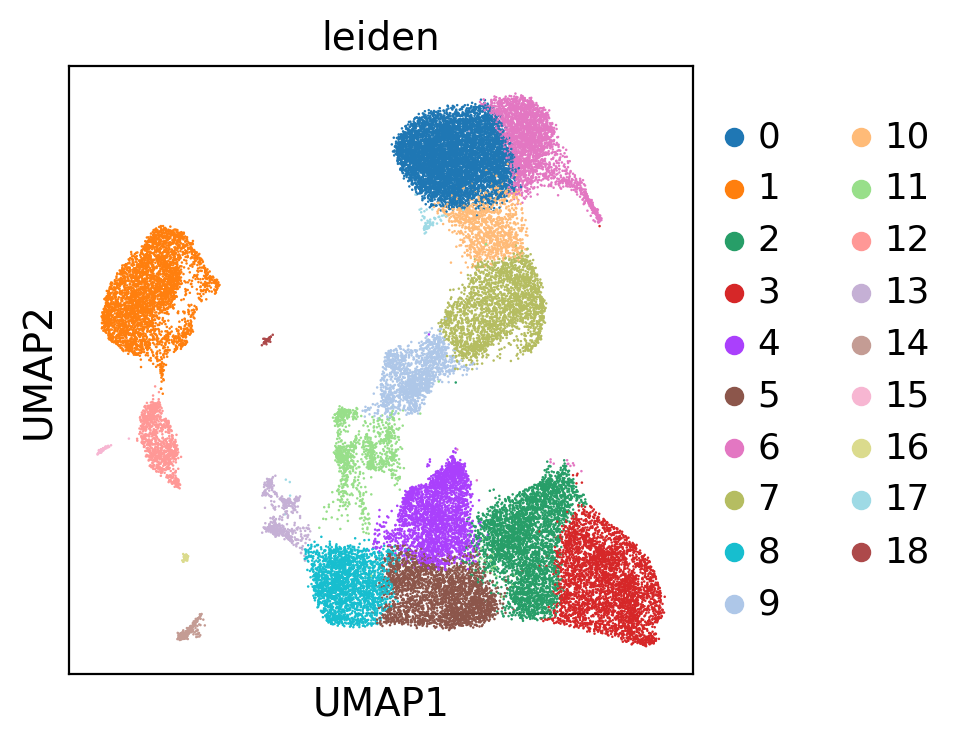

In [269]:
scjp.us(bdata,'leiden'.split(','))

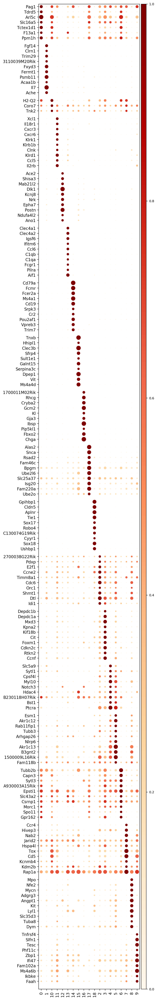

{'0': ['Pag1', 'Tdrd5', 'Arl5c', 'Slc16a5', 'Tctex1d1', 'F13a1', 'Ppm1h'],
 '1': ['Fgf14',
  'Clrn1',
  'Trim29',
  '3110039M20Rik',
  'Fxyd3',
  'Fermt1',
  'Psmb11',
  'Acaa1b',
  'Il7',
  'Ache'],
 '10': ['H2-Q2', 'Coro7', 'Tnk2'],
 '11': ['Xcl1',
  'Il18r1',
  'Cxcr3',
  'Cxcr6',
  'Klrk1',
  'Klrb1b',
  'Clnk',
  'Klrd1',
  'Ccl5',
  'Il2rb'],
 '12': ['Ace2',
  'Shisa3',
  'Mab21l2',
  'Dlk1',
  'Kcnj8',
  'Nrk',
  'Epha7',
  'Postn',
  'Ndufa4l2',
  'Ano1'],
 '13': ['Clec4a1',
  'Clec4a2',
  'Igsf6',
  'Ifitm6',
  'Ccl6',
  'C1qb',
  'C1qa',
  'Fcgr1',
  'Pilra',
  'Aif1'],
 '14': ['Cd79a',
  'Fcmr',
  'Fcer2a',
  'Ms4a1',
  'Cd19',
  'Srpk3',
  'Cr2',
  'Pou2af1',
  'Vpreb3',
  'Trim7'],
 '15': ['Tnxb',
  'Hhipl1',
  'Clec3b',
  'Sfrp4',
  'Sult1e1',
  'Galnt15',
  'Serpina3c',
  'Dpep1',
  'Vit',
  'Ms4a4d'],
 '16': ['1700011M02Rik',
  'Rhcg',
  'Cryba2',
  'Gcm2',
  'Kl',
  'Gja3',
  'Ibsp',
  'Pip5kl1',
  'Fbxo2',
  'Chga'],
 '17': ['Alas2',
  'Snca',
  'Rsad2',
  'Fam46c',
 

In [270]:
mks = markers.find_markers(bdata,'leiden')
markers.show_marker_plot(bdata,'leiden',mks)

In [294]:
bdata.obs['anno_level_8'] = 'unknown'
arr = np.array(bdata.obs['anno_level_8'],dtype=object)
arr[bdata.obs['leiden']=='4'] = 'DN(Q)'
arr[bdata.obs['leiden'].isin('8,5'.split(','))] = 'DN(P)'
arr[bdata.obs['leiden']=='18'] = 'Endo'
arr[bdata.obs['leiden']=='16'] = 'Epi_Gcm2'
arr[bdata.obs['anno_level_7']=='B'] = 'B'
arr[bdata.obs['anno_level_7']=='B-T_doublet'] = 'B-T_doublet'
arr[bdata.obs['anno_level_7']=='Ery'] = 'Ery'
arr[bdata.obs['leiden'].isin('15,12'.split(','))] = 'Fb'
arr[bdata.obs['leiden'].isin('1'.split(','))] = 'TEC'
arr[bdata.obs['leiden'].isin('13'.split(','))] = 'Immune'
arr[bdata.obs['leiden'].isin('11'.split(','))] = 'Innate_T'
bdata.obs['anno_level_8'] = arr


In [297]:
model.update_label(bdata,'anno_level_7',bdata,'anno_level_8','anno_level_9',unknown='unknown')

... storing 'anno_level_9' as categorical


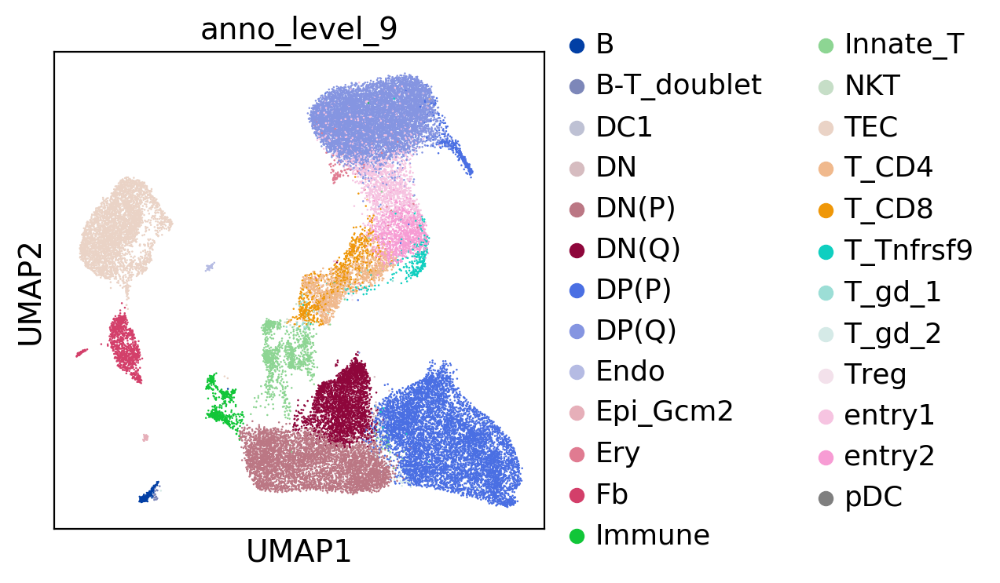

In [298]:
scjp.us(bdata,'anno_level_9'.split(','))

In [300]:
sc.tl.leiden(bdata,resolution=4.0)

running Leiden clustering
    finished (0:01:23.83) --> found 46 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


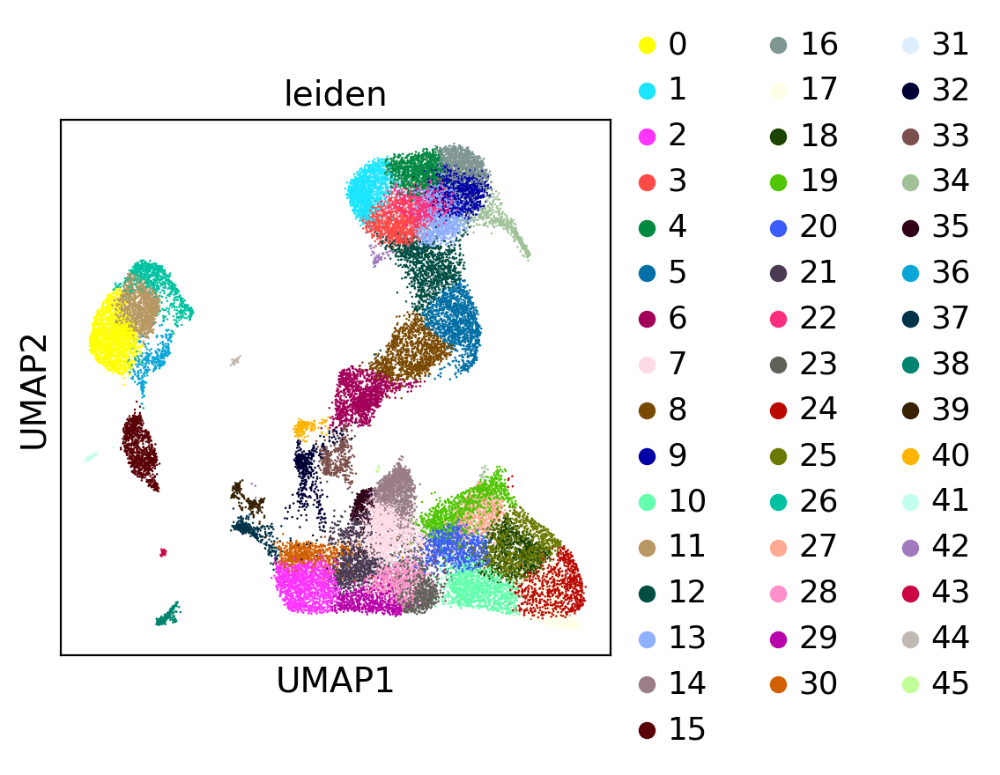

In [301]:
scjp.us(bdata,'leiden')

In [309]:
TEC = bdata[bdata.obs['anno_level_9']=='TEC']

In [336]:
sc.tl.leiden(TEC,resolution=2.0)

running Leiden clustering
    finished (0:00:03.07) --> found 18 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


In [347]:
TEC.obs['anno_level_10'] = 'unknown'

In [754]:
ann = scjp.annotater(TEC,'anno_level_10')

In [755]:
ann.update_condi(TEC, TEC.obs['leiden']=='5','mTEC_early')
ann.update_condi(TEC, TEC.obs['leiden']=='8','mTEC')
ann.update_condi(TEC, TEC.obs['leiden']=='15','TEC_unknown_2')


In [756]:
ann.update_condi(TEC,TEC.obs['anno_level_10']=='unknown','cTEC')

... storing 'anno_level_10' as categorical


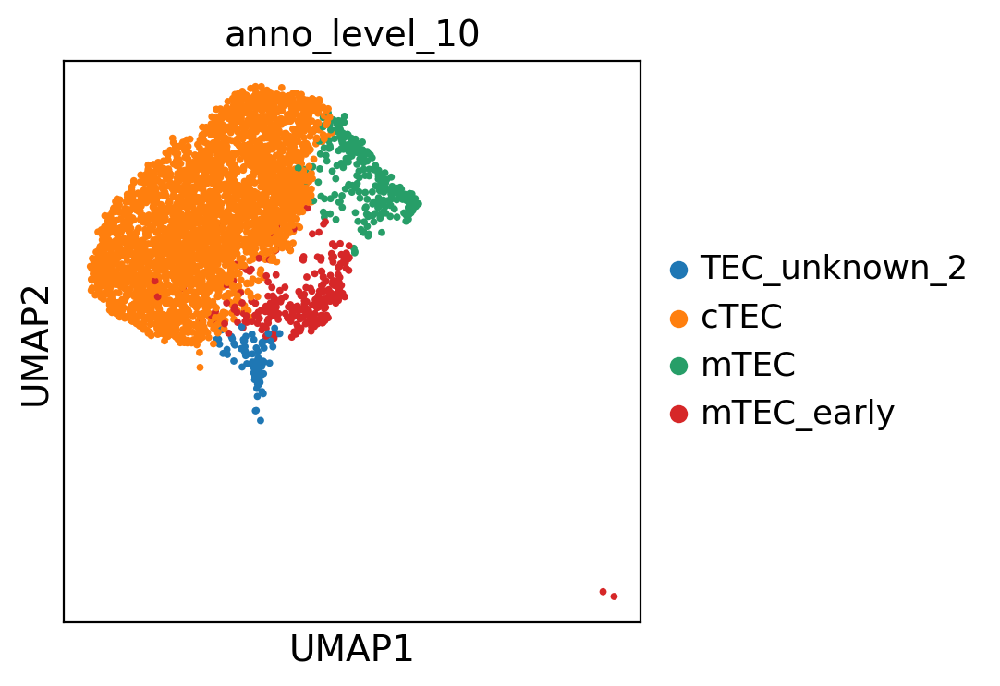

In [757]:
scjp.us(TEC,'anno_level_10')

In [372]:
Immune = bdata[bdata.obs['anno_level_9']=='Immune']

In [376]:
sc.tl.umap(Immune)

computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:01.71) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [453]:
sc.tl.leiden(Immune,resolution=2)

running Leiden clustering
    finished (0:00:00.24) --> found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


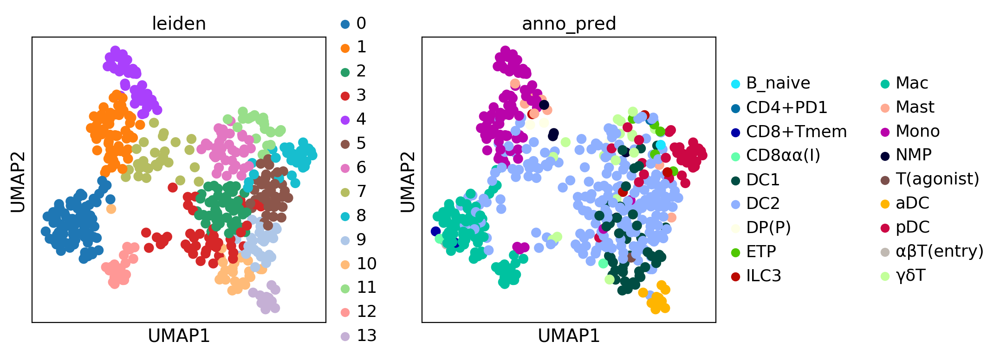

In [454]:
scjp.us(Immune,'leiden,anno_pred')

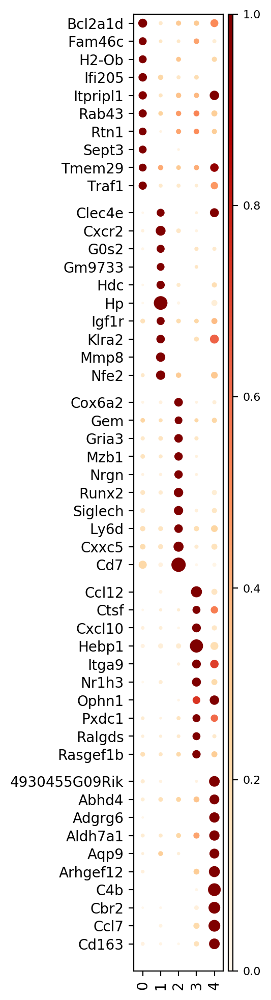

{'0': ['Bcl2a1d',
  'Fam46c',
  'H2-Ob',
  'Ifi205',
  'Itpripl1',
  'Rab43',
  'Rtn1',
  'Sept3',
  'Tmem29',
  'Traf1'],
 '1': ['Clec4e',
  'Cxcr2',
  'G0s2',
  'Gm9733',
  'Hdc',
  'Hp',
  'Igf1r',
  'Klra2',
  'Mmp8',
  'Nfe2'],
 '2': ['Cox6a2',
  'Gem',
  'Gria3',
  'Mzb1',
  'Nrgn',
  'Runx2',
  'Siglech',
  'Ly6d',
  'Cxxc5',
  'Cd7'],
 '3': ['Ccl12',
  'Ctsf',
  'Cxcl10',
  'Hebp1',
  'Itga9',
  'Nr1h3',
  'Ophn1',
  'Pxdc1',
  'Ralgds',
  'Rasgef1b'],
 '4': ['4930455G09Rik',
  'Abhd4',
  'Adgrg6',
  'Aldh7a1',
  'Aqp9',
  'Arhgef12',
  'C4b',
  'Cbr2',
  'Ccl7',
  'Cd163']}

In [428]:
mks = markers.find_markers(Immune,'leiden',min_cnt_cut=10)
markers.show_marker_plot(Immune,'leiden',mks)

In [439]:
ann  = scjp.annotater(Immune,'temp')

In [460]:

for label in ['DC1','Mac','Mono','NMP','pDC','aDC']:
    ann.update(Immune,Immune.obs['anno_pred']==label,label)
ann.update(Immune,Immune.obs['leiden'].isin('7,6'.split(',')),'HSC')
ann.update(Immune,Immune.obs['leiden'].isin('2,5,3,9'.split(',')),'DC2')

... storing 'temp' as categorical


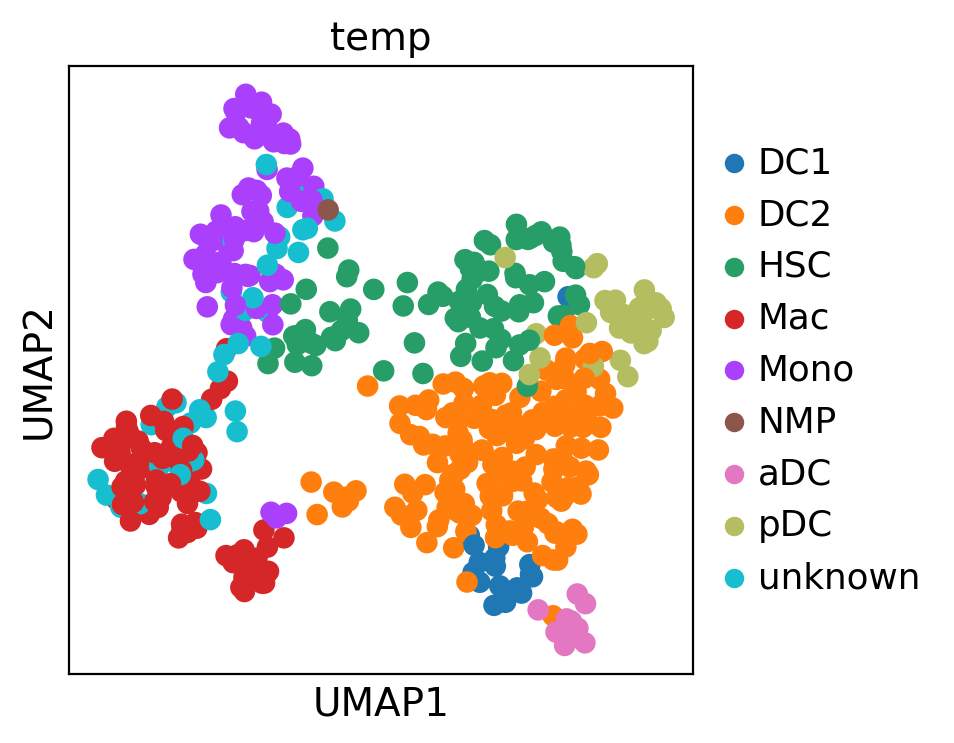

In [461]:
scjp.us(Immune,'temp')

creating lr model...
making lr prediction...
updating lr to adata...


LogisticRegression(C=0.2, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

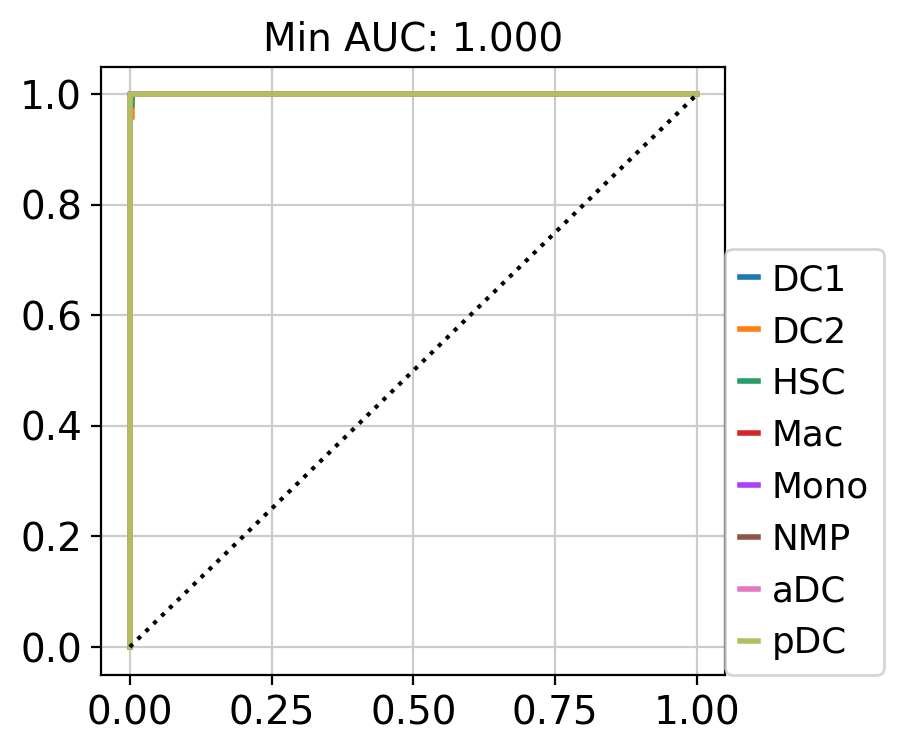

In [462]:
model.transfer_annotation_jp(Immune,'temp',Immune,'anno_level_10',exclude='unknown')

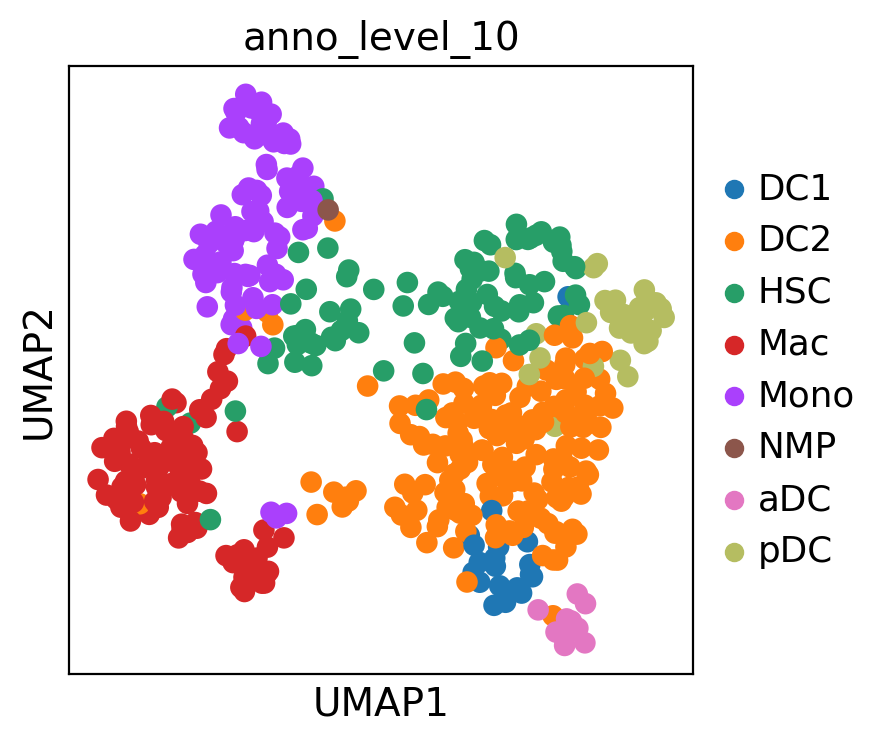

In [466]:
scjp.us(Immune,'anno_level_10')

In [467]:
Fb =  bdata[bdata.obs['anno_level_9']=='Fb']

In [470]:
sc.tl.leiden(Fb)

running Leiden clustering
    finished (0:00:00.47) --> found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


In [476]:
ann = scjp.annotater(Fb,'anno_level_10','anno_level_9')

In [477]:
ann.update(Fb,'leiden','6','VSMC')

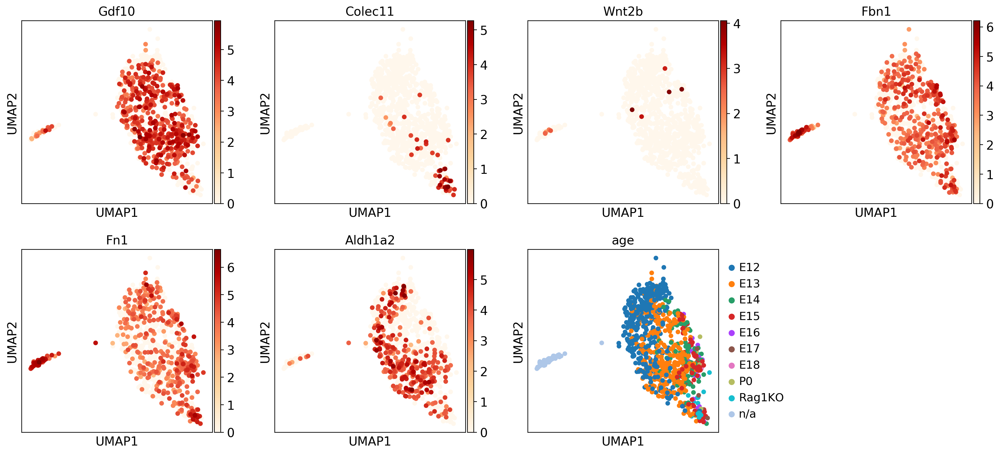

In [488]:
scjp.us(Fb,'Gdf10,Colec11,Wnt2b,Fbn1,Fn1,Aldh1a2,age')

## add tcr information

In [596]:
tcr = sc.read('/mnt/08_thymus_cell_atlas/06_Mouse/Thymus_mouse_organogenesis_Kernsfeld2018_tcr.h5ad')

In [607]:
bdata.obs_names = merged.obs_names

In [608]:
newobs= []
for x in bdata.obs_names:
    if 'GSM' in x:
        barcode = x.split("-")[0]
        Exp = '_'.join(x.split("_")[1:])
        newobs.append(Exp+'-'+barcode)
    else:
        newobs.append(x)

In [611]:
bdata.obs_names = newobs

In [612]:
tcr.obs['trac'] = tcr.X[:,tcr.var_names=='Trac'].todense().A1
tcr.obs['trdc'] = tcr.X[:,tcr.var_names=='Trdc'].todense().A1

In [613]:
ndata_subset.obs['trac'] = ndata_subset.raw.X[:,ndata_subset.raw.var_names=='Trac'].todense().A1
ndata_subset.obs['trdc'] = ndata_subset.raw.X[:,ndata_subset.raw.var_names=='Trdc'].todense().A1

In [640]:
tcr.obs['trac'] = np.array(tcr.obs['trac']>0,dtype=int)
tcr.obs['trdc'] = np.array(tcr.obs['trdc']>0,dtype=int)

In [634]:
ndata_subset.obs['trac'] = ndata_subset.obs['trac']/np.max(ndata_subset.obs['trac'])
ndata_subset.obs['trdc'] = ndata_subset.obs['trdc']/np.max(ndata_subset.obs['trdc'])

In [643]:
bdata.obs['trac'] = 0
bdata.obs['trdc'] = 0

model.update_label(tcr,'trac',bdata,'trac','trac',replace=True)
model.update_label(tcr,'trdc',bdata,'trdc','trdc',replace=True)
model.update_label(ndata_subset,'trac',bdata,'trac','trac',replace=True)
model.update_label(ndata_subset,'trdc',bdata,'trdc','trdc',replace=True)

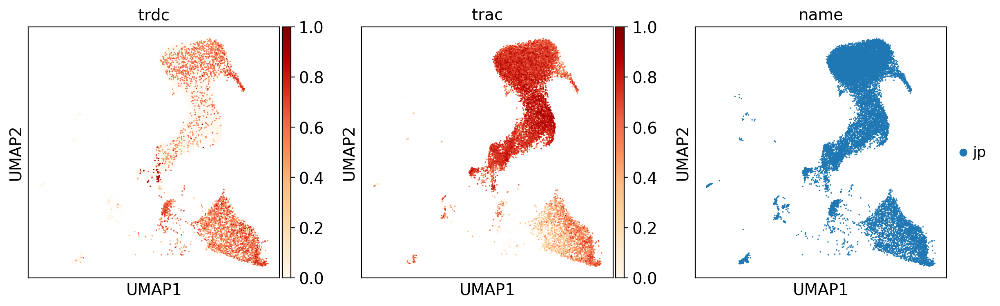

In [646]:
scjp.us(bdata[bdata.obs['name']=='jp'],'trdc,trac,name')


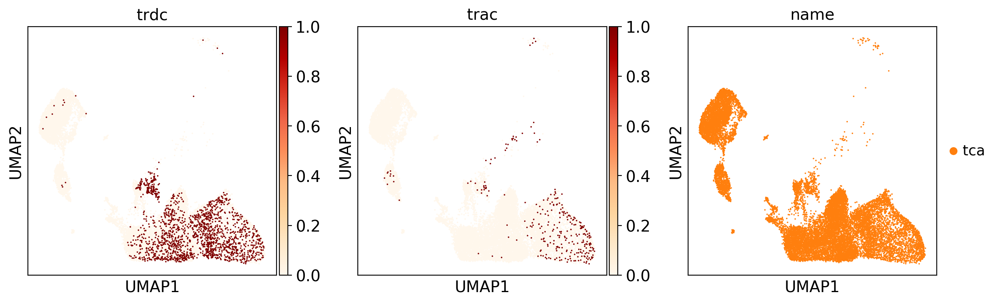

In [647]:
scjp.us(bdata[bdata.obs['name']=='tca'],'trdc,trac,name')

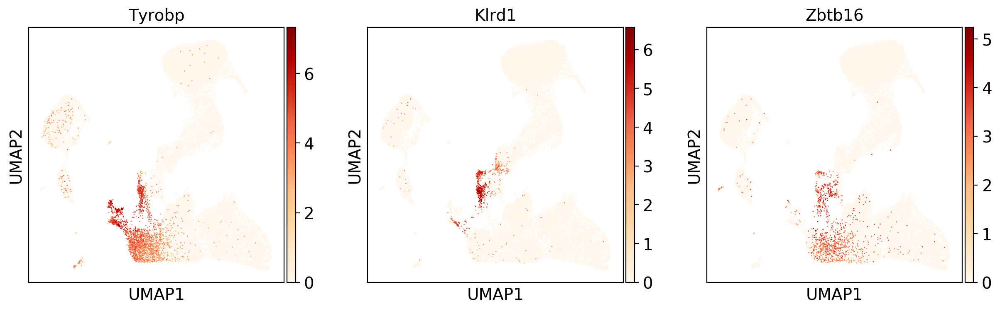

In [648]:
scjp.us(bdata,'Tyrobp,Klrd1,Zbtb16')

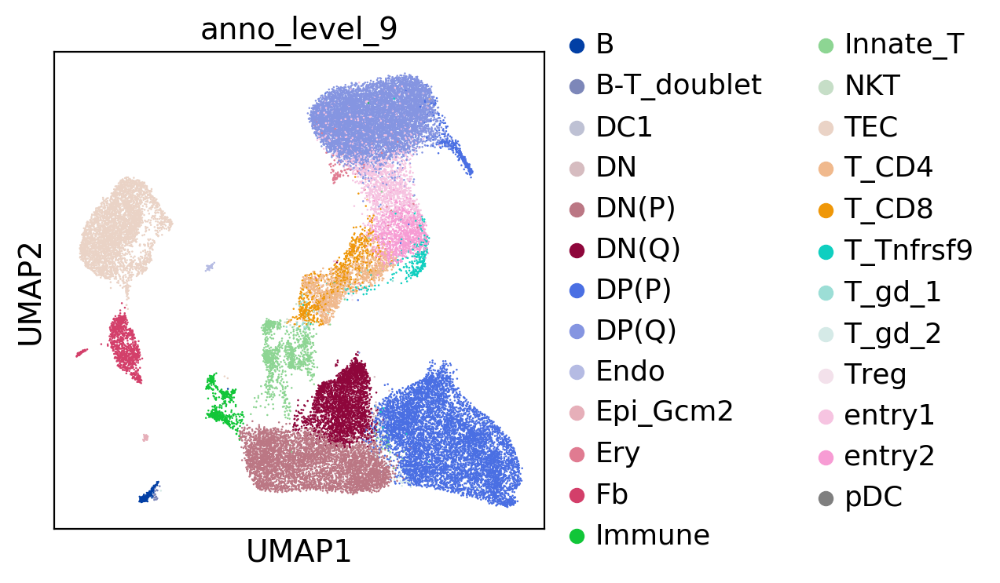

In [649]:
scjp.us(bdata,'anno_level_9')

In [740]:
c1 = bdata.obs['anno_level_9'].isin("Innate_T,NKT".split(','))
c2 = bdata.obs['name'] == 'tca'

Innate = bdata[c1&c2]

In [748]:
Innate2 = bdata[c1&~c2]

In [741]:
sc.tl.umap(Innate)

computing UMAP
    using 'X_pca' with n_pcs = 50


Trying to set attribute `.obsm` of view, making a copy.


    finished (0:00:02.98) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [742]:
sc.tl.leiden(Innate,resolution=0.5)

running Leiden clustering
    finished (0:00:00.20) --> found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


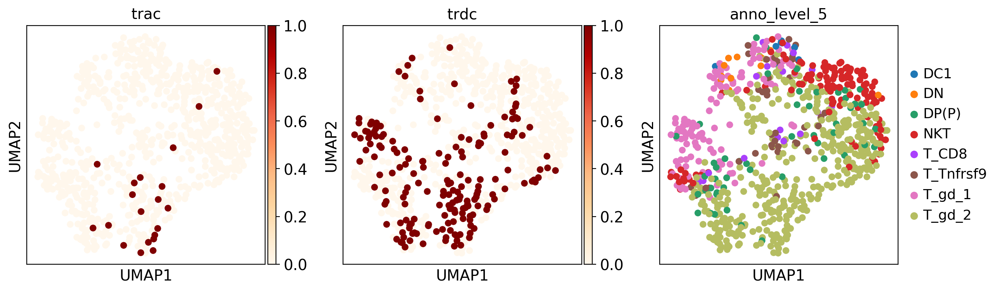

In [743]:
scjp.us(Innate,'trac,trdc,anno_level_5')

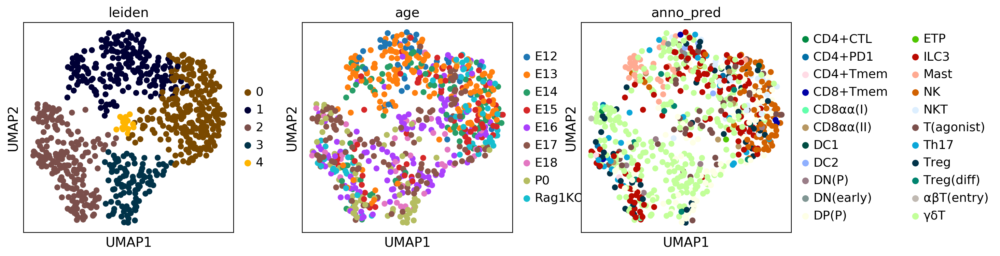

In [744]:
scjp.us(Innate,'leiden,age,anno_pred')

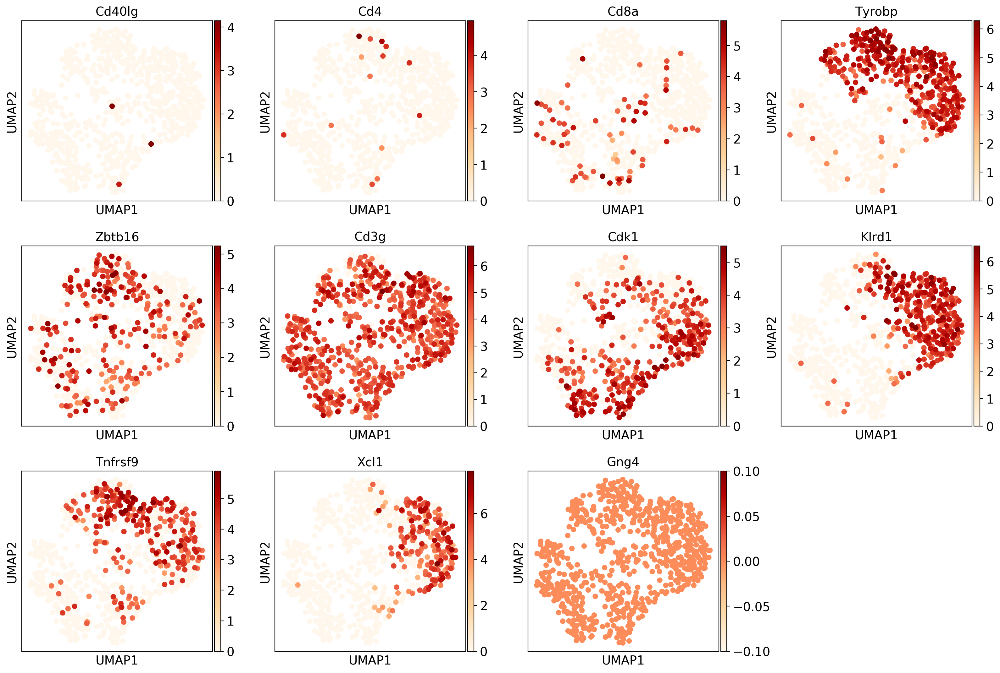

In [713]:
scjp.us(Innate,'Cd40lg,Cd4,Cd8a,Tyrobp,Zbtb16,Cd3g,Cdk1,Klrd1,Tnfrsf9,Xcl1,Gng4')

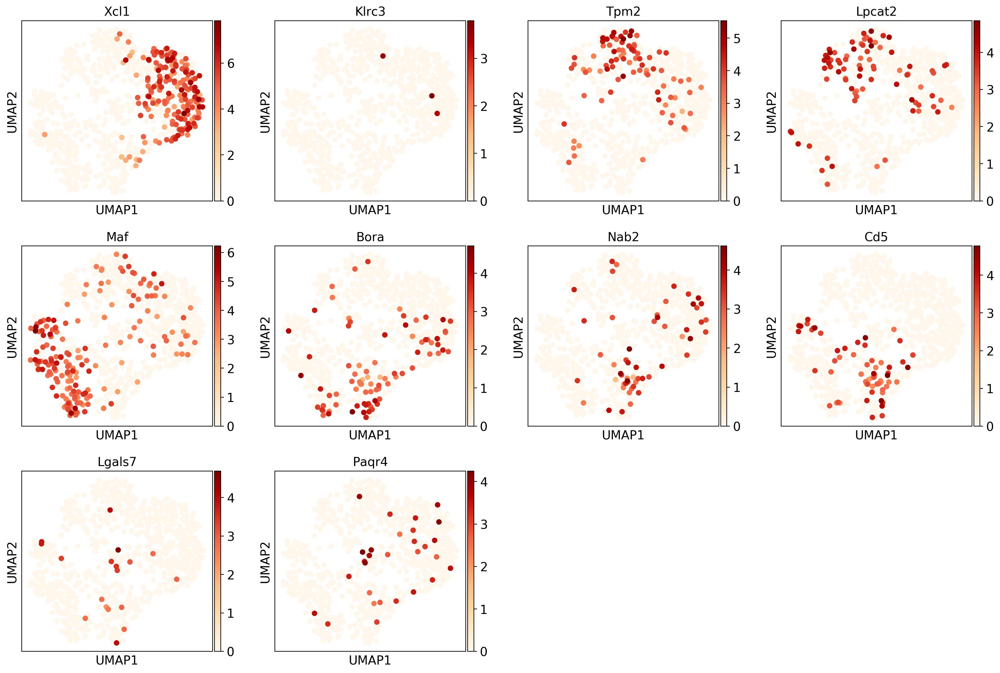

In [722]:
scjp.us(Innate,'Xcl1,Klrc3,Tpm2,Lpcat2,Maf,Bora,Nab2,Cd5,Lgals7,Paqr4')

In [745]:
ann = scjp.annotater(Innate,'anno_level_10')
ann.update(Innate,'leiden','0,1','NK')
ann.update(Innate,'leiden','2,3,4','T_gd')

## Finalise annotations

In [758]:
model.update_label(Innate,'anno_level_10',bdata,'anno_level_9','anno_level_10',replace=True)
model.update_label(Immune,'anno_level_10',bdata,'anno_level_10','anno_level_10',replace=True)
model.update_label(TEC,'anno_level_10',bdata,'anno_level_10','anno_level_10',replace=True)
model.update_label(Fb,'anno_level_10',bdata,'anno_level_10','anno_level_10',replace=True)

In [759]:
model.update_label(Innate2,'anno_level_5',bdata,'anno_level_10','anno_level_10',replace=True)

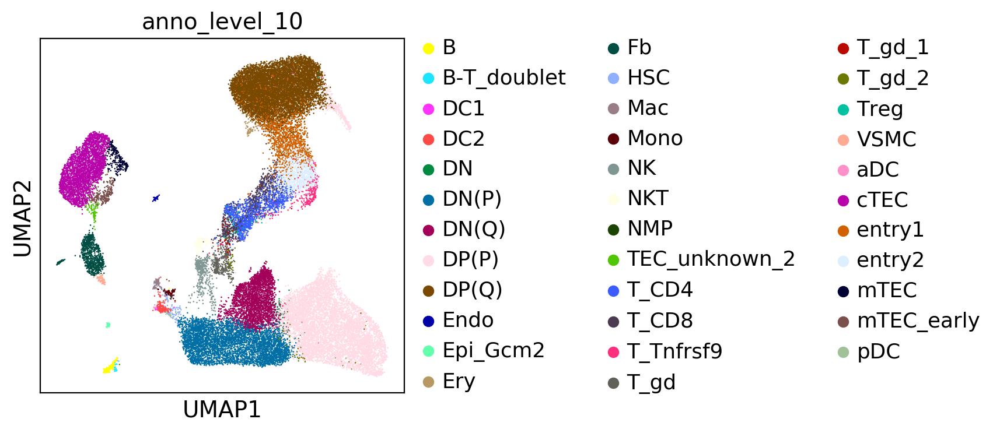

In [761]:
scjp.us(bdata,'anno_level_10')

In [763]:
ann = scjp.annotater(bdata,'anno_level_11',old_label='anno_level_10')
ann.update(bdata,'anno_level_10','T_gd_1,T_gd_2,T_gd','T_gd')

... storing 'anno_level_11' as categorical


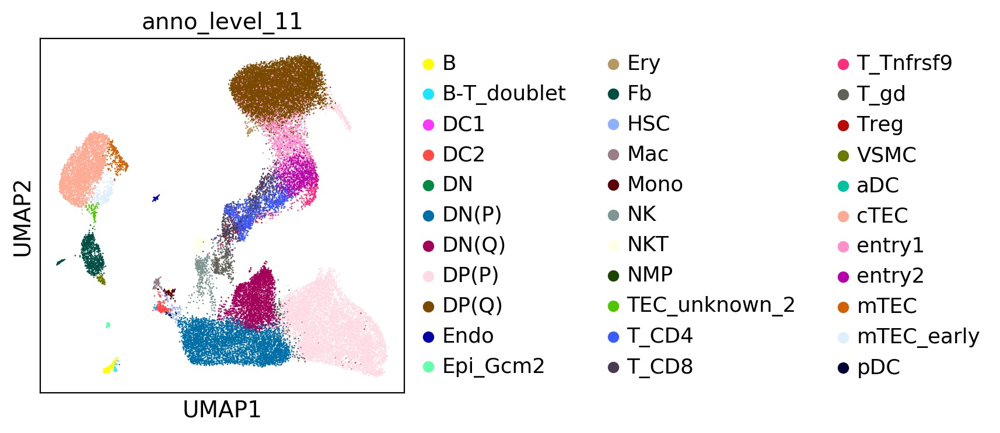

In [764]:
scjp.us(bdata,'anno_level_11')

## Finished mouse annotation -> save

In [766]:
scjp.write(bdata,version,'mouse_merged_annotated')

Only considering the two last: ['.A02', '.mouse_merged_annotated'].
HTA08_v01_A02_mouse_merged_annotated = 'HTA08.v01.A02.mouse_merged_annotated'


In [ ]:
bdata

## Open stromal data

In [784]:
ido = sc.read('./06_Mouse/Bornstein2018_mthymus_stroma_merged_annotated5.h5ad')

In [785]:
ido = scjp.get_subset(ido,ido.obs['anno_broad']!='jp24',cc_genes=mouse_cc_genes)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.46)


In [1015]:
scjp.sc_process(ido,pid='nul')

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:03.56) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:18.49) --> added
    'X_umap', UMAP coordinates (adata.obsm)
running Leiden clustering
    finished (0:00:01.19) --> found 21 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


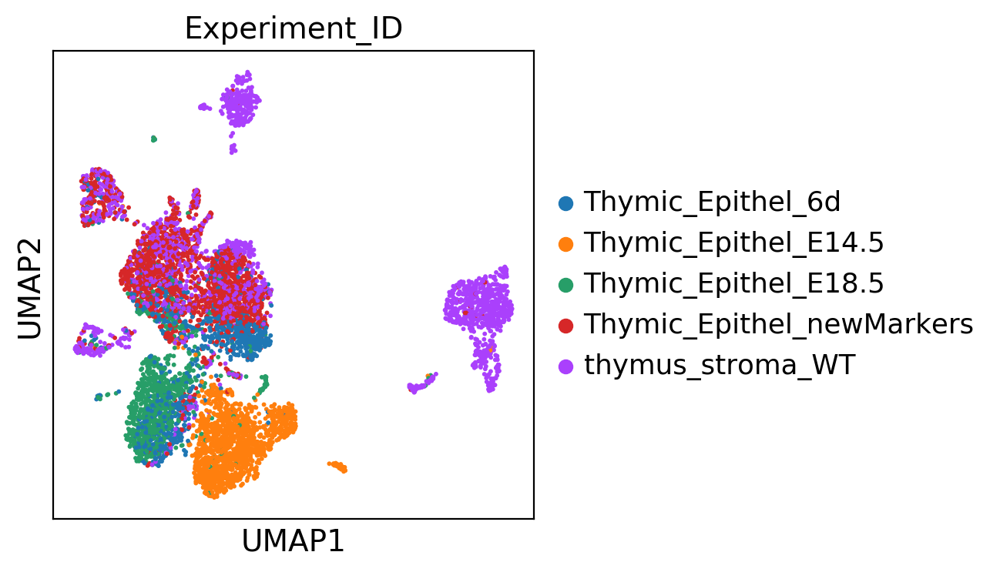

In [793]:
scjp.us(ido,'Experiment_ID')

In [796]:
ido_cm, bdata_cm = model.get_common_var_raw(ido,bdata)

calculating a...
calculating b...


creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...
updating lr to adata...


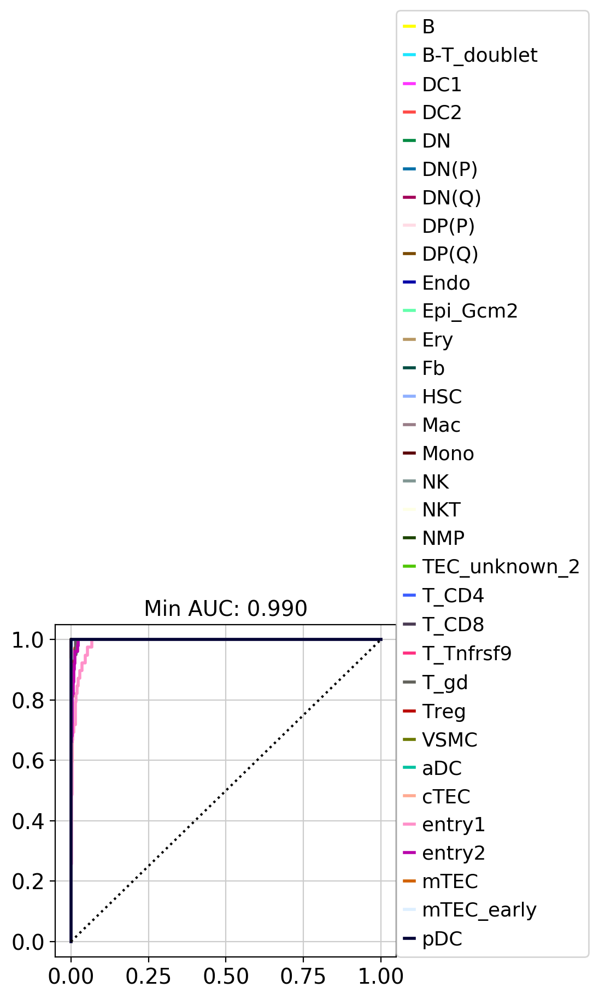

In [800]:
lr_bdata = model.transfer_annotation_jp(bdata_cm,'anno_level_11',ido_cm,'anno_level_11',raw=False)

In [802]:
ido.obs['anno_level_11'] = ido_cm.obs['anno_level_11']

In [807]:
ido_mth = ido.copy()

In [811]:
new_names = [mouse_to_human(x) for x in ido.raw.var_names]

In [814]:
ido_raw = sc.AnnData(ido.raw.X)
ido_raw.var_names = new_names
ido_mth.raw = ido_raw

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [815]:
ido_cm, human_cm = model.get_common_var_raw(ido_mth,human)

calculating a...
calculating b...


creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...
updating lr to adata...


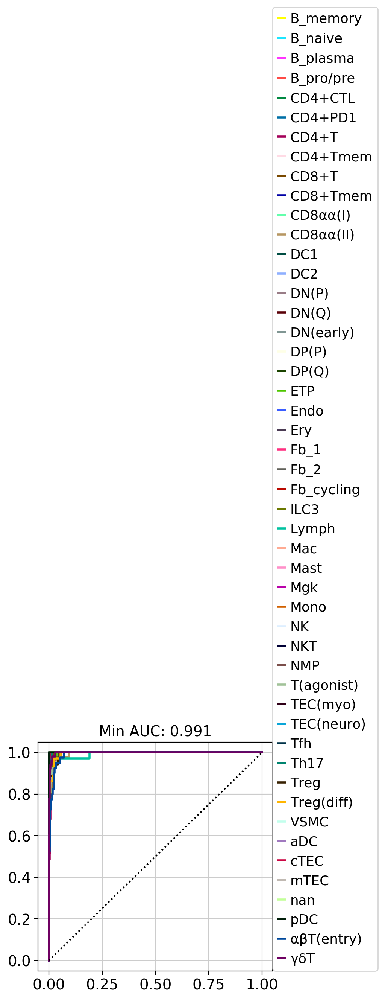

In [816]:
lr_bdata = model.transfer_annotation_jp(human_cm,'Anno_level_5',ido_cm,'anno_pred',raw=False)

In [817]:
ido.obs['anno_pred'] = ido_cm.obs['anno_pred']

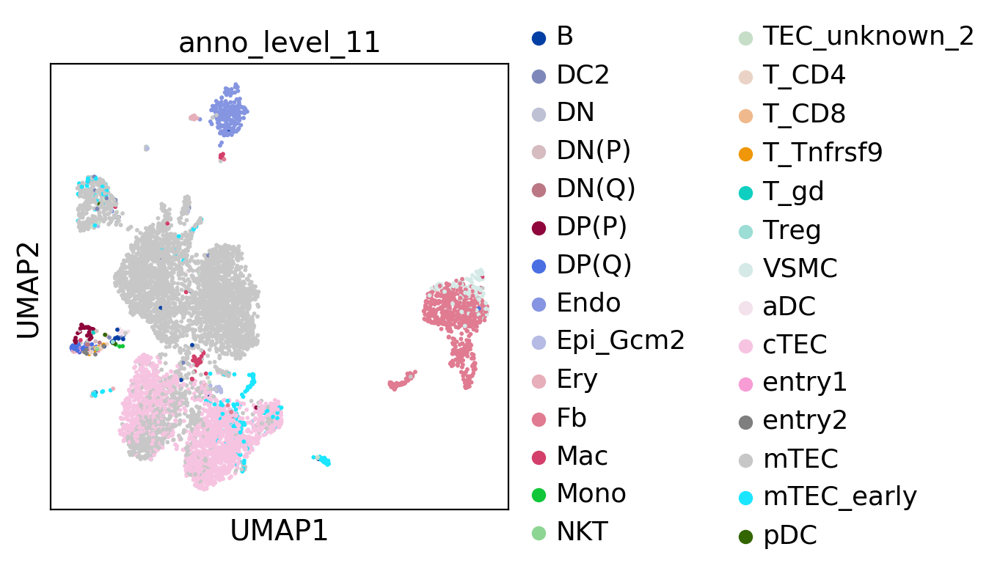

In [820]:
scjp.us(ido_cm,'anno_level_11')

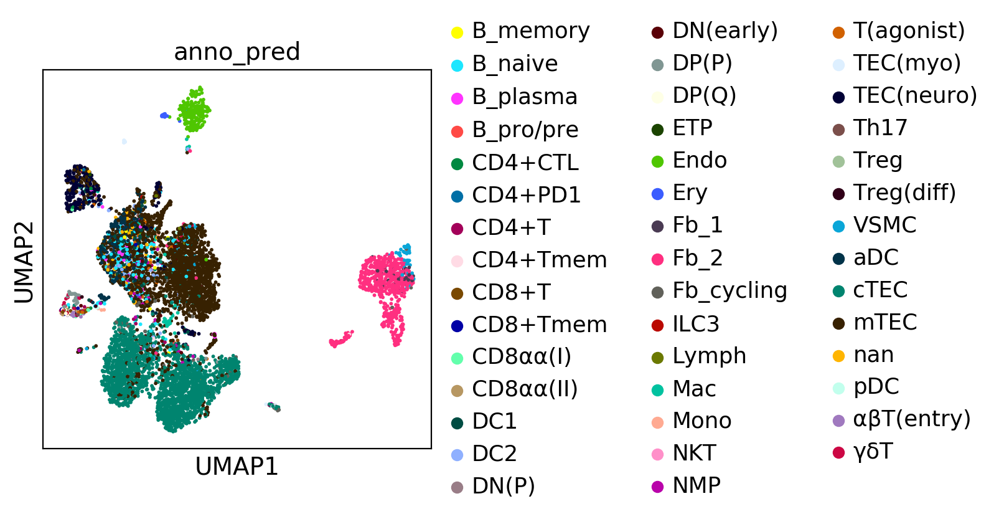

In [845]:
scjp.us(ido_cm,'anno_pred')

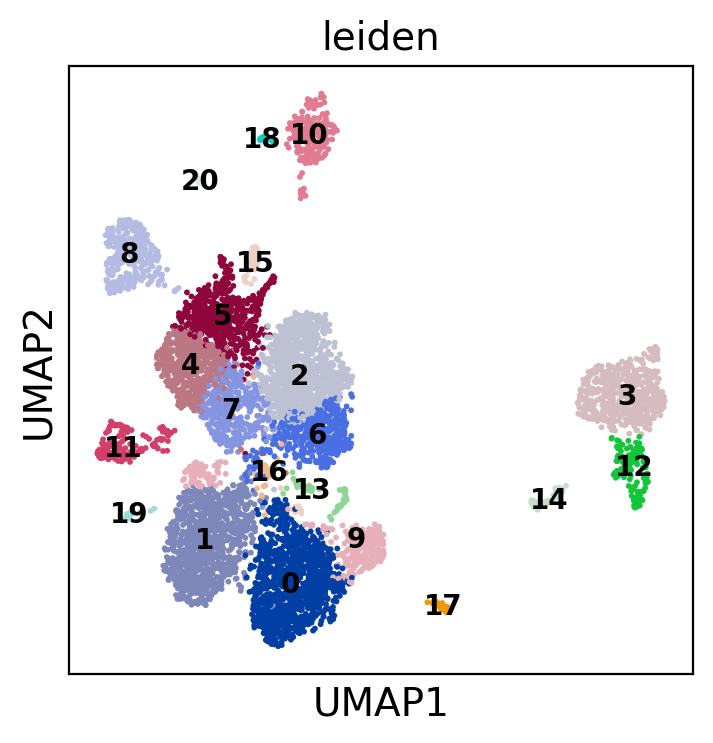

In [822]:
scjp.us(ido,'leiden',legend_loc='on data', legend_fontsize=10)

In [927]:
Counter(ido.obs['anno_pred'][ido.obs['leiden']=='16'])

Counter({'Mac': 31, 'cTEC': 2, 'mTEC': 2, 'DC2': 2})

In [1016]:
ido.obs['anno_level_12'] = 'mTEC'
ann = scjp.annotater(ido,'anno_level_12',old_label='anno_level_12')

In [1017]:
ann.update(ido,'leiden','11','Immune')
ann.update(ido,'leiden','8','mTEC_IV(tuft)')
ann.update(ido,'leiden','20','muscle')
ann.update(ido,'leiden','18','Ery')
ann.update(ido,'leiden','10','Endo')
ann.update(ido,'leiden','15','TEC(neuro)_like_1')
ann.update(ido,'leiden','13','TEC(neuro)_like_2')
ann.update(ido,'leiden','9','cTEC(cycling)')
ann.update(ido,'leiden','1,0','cTEC')
ann.update(ido,'leiden','19','Epi(lung)')
ann.update(ido,'leiden','17','Epi_PAX8')
ann.update(ido,'leiden','14','Fb_Aldh1a2')
ann.update(ido,'leiden','12','Fb_Pi16')
ann.update(ido,'leiden','3','Fb_Postn')
ann.update(ido,'leiden','16','Mac')
ann.update(ido,'anno_level_11','Epi_Gcm2','Epi_Gcm2')

In [790]:
mks = markers.marker(ido,'leiden')

/mnt/thymus_atlas/scjp/markers.py:177: RuntimeWarning:

invalid value encountered in true_divide



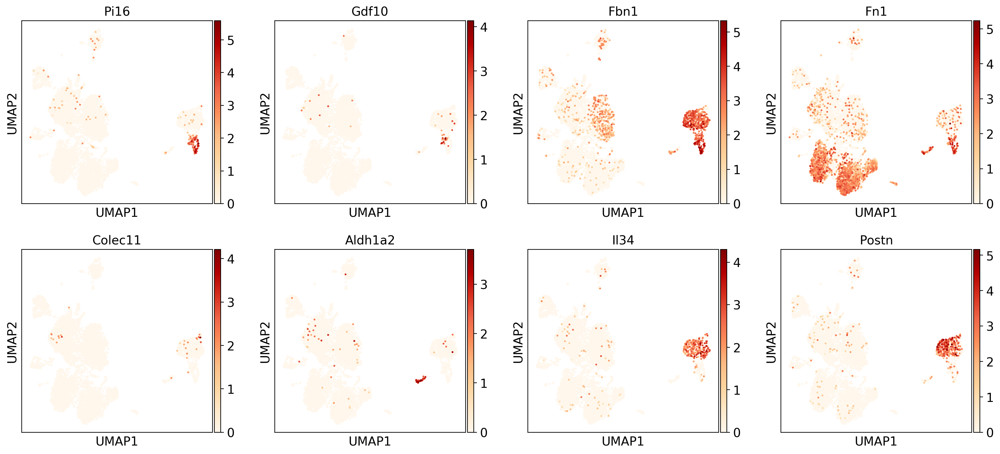

In [924]:
scjp.us(ido,'Pi16,Gdf10,Fbn1,Fn1,Colec11,Aldh1a2,Il34,Postn')

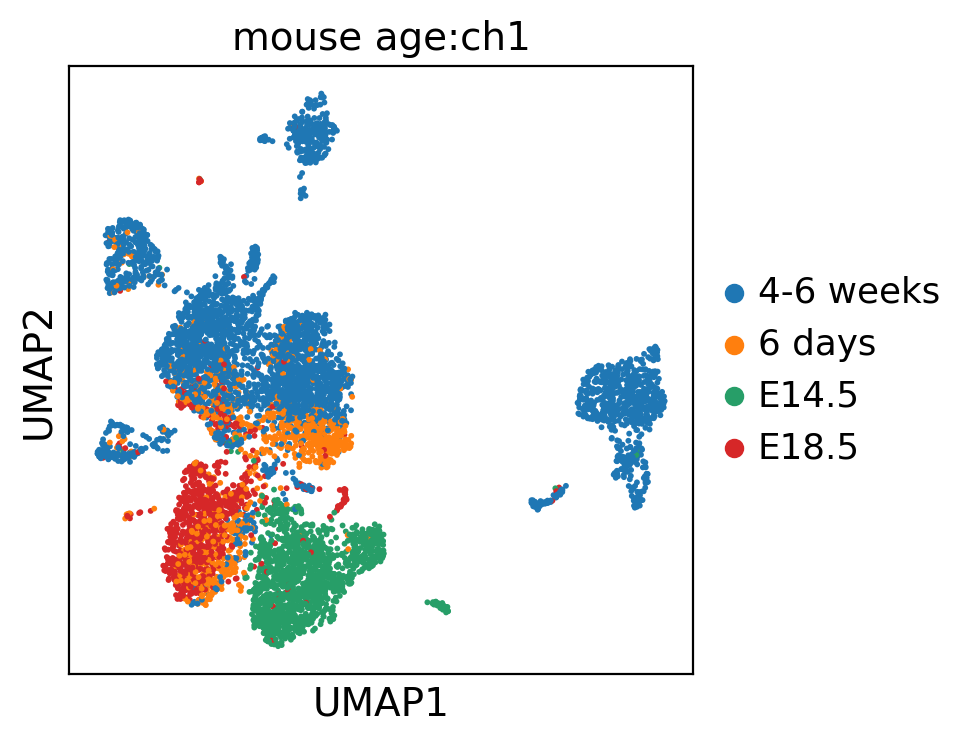

In [1197]:
scjp.us(ido,'mouse age:ch1')

... storing 'anno_level_12' as categorical


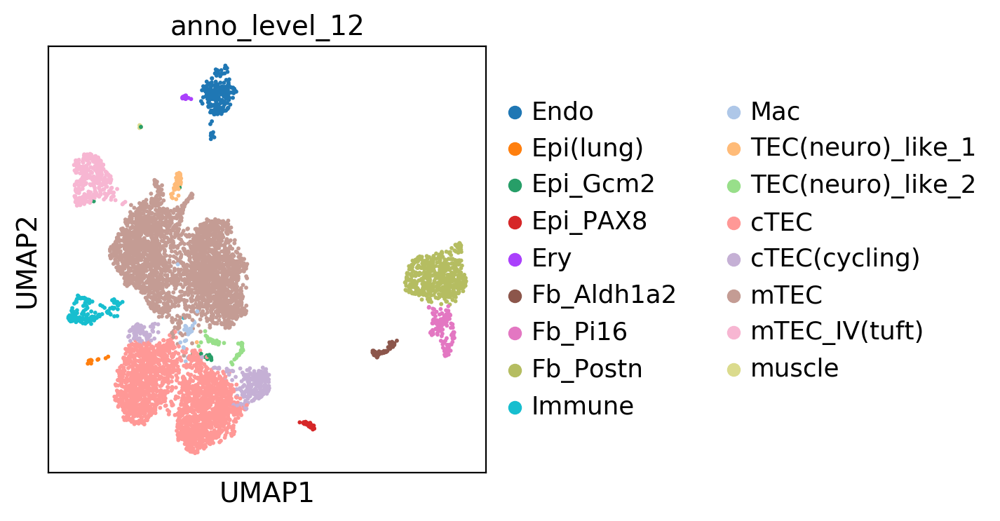

In [1018]:
scjp.us(ido,'anno_level_12')

In [1019]:
sc.tl.leiden(ido,resolution=5.0)

running Leiden clustering
    finished (0:00:02.02) --> found 62 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


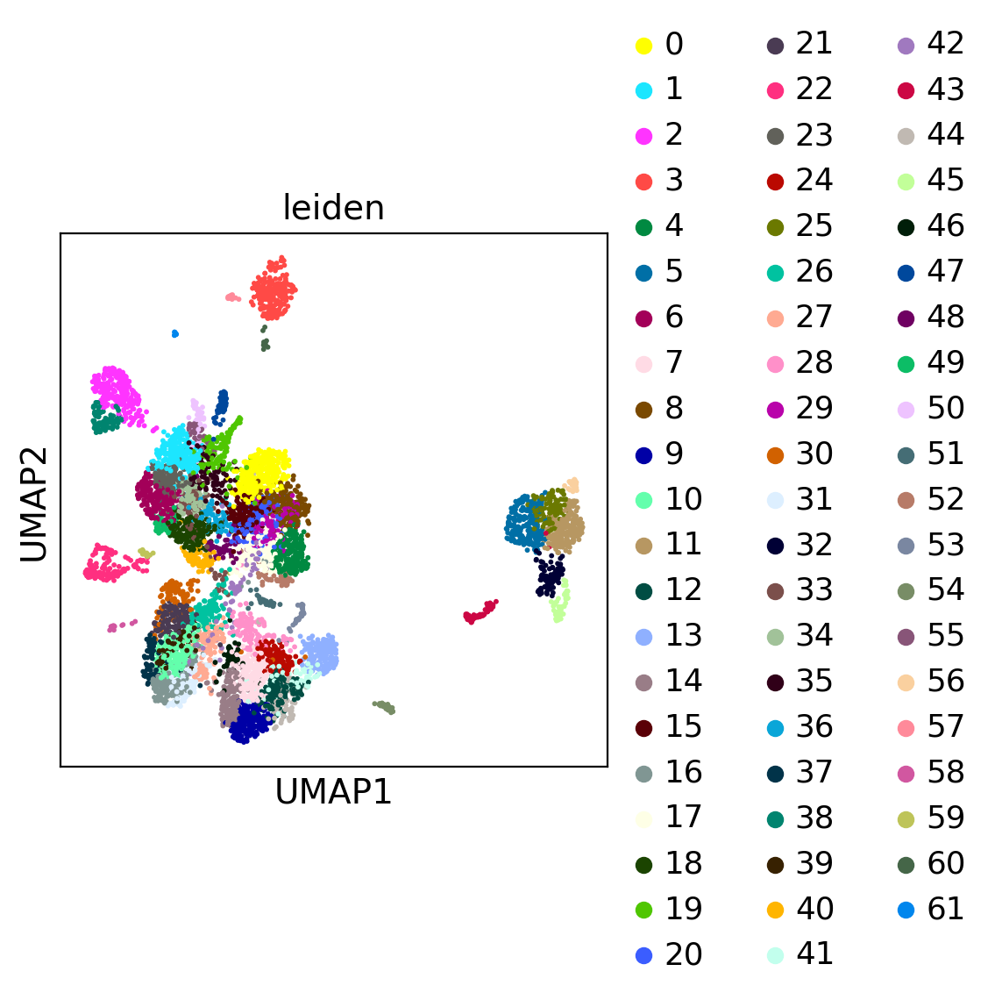

In [1020]:
scjp.us(ido,'leiden')

In [1021]:
ann.update(ido,'leiden','56','VSMC')

In [933]:
mTEC = ido[ido.obs['anno_level_12']=='mTEC']

In [945]:
sc.tl.leiden(mTEC,resolution=0.5)

running Leiden clustering
    finished (0:00:00.46) --> found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


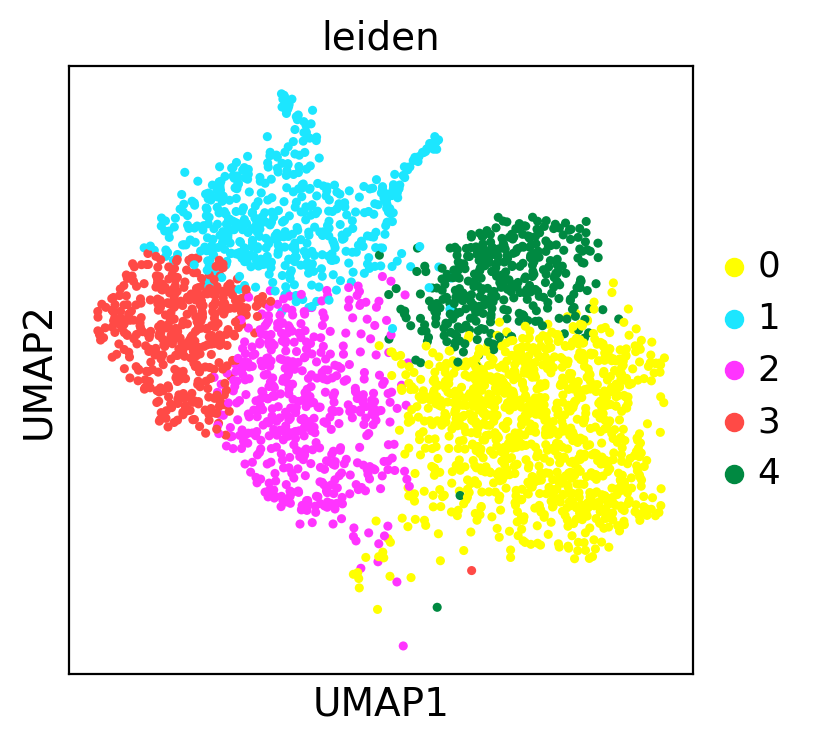

In [946]:
scjp.us(mTEC,'leiden')

In [953]:
ann = scjp.annotater(mTEC,'anno_level_13')

In [955]:
ann.update(mTEC,'leiden','1','mTEC_III')
ann.update(mTEC,'leiden','2,3','mTEC_II')
ann.update(mTEC,'leiden','0,4','mTEC_I')

In [937]:
mks= markers.marker(mTEC,'leiden')

/mnt/thymus_atlas/scjp/markers.py:180: RuntimeWarning:

invalid value encountered in true_divide



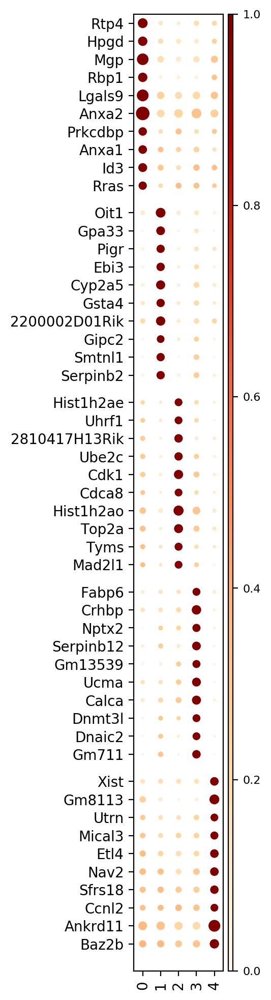

{'0': ['Rtp4',
  'Hpgd',
  'Mgp',
  'Rbp1',
  'Lgals9',
  'Anxa2',
  'Prkcdbp',
  'Anxa1',
  'Id3',
  'Rras'],
 '1': ['Oit1',
  'Gpa33',
  'Pigr',
  'Ebi3',
  'Cyp2a5',
  'Gsta4',
  '2200002D01Rik',
  'Gipc2',
  'Smtnl1',
  'Serpinb2'],
 '2': ['Hist1h2ae',
  'Uhrf1',
  '2810417H13Rik',
  'Ube2c',
  'Cdk1',
  'Cdca8',
  'Hist1h2ao',
  'Top2a',
  'Tyms',
  'Mad2l1'],
 '3': ['Fabp6',
  'Crhbp',
  'Nptx2',
  'Serpinb12',
  'Gm13539',
  'Ucma',
  'Calca',
  'Dnmt3l',
  'Dnaic2',
  'Gm711'],
 '4': ['Xist',
  'Gm8113',
  'Utrn',
  'Mical3',
  'Etl4',
  'Nav2',
  'Sfrs18',
  'Ccnl2',
  'Ankrd11',
  'Baz2b']}

In [938]:
mks.plot_marker()

... storing 'anno_level_13' as categorical


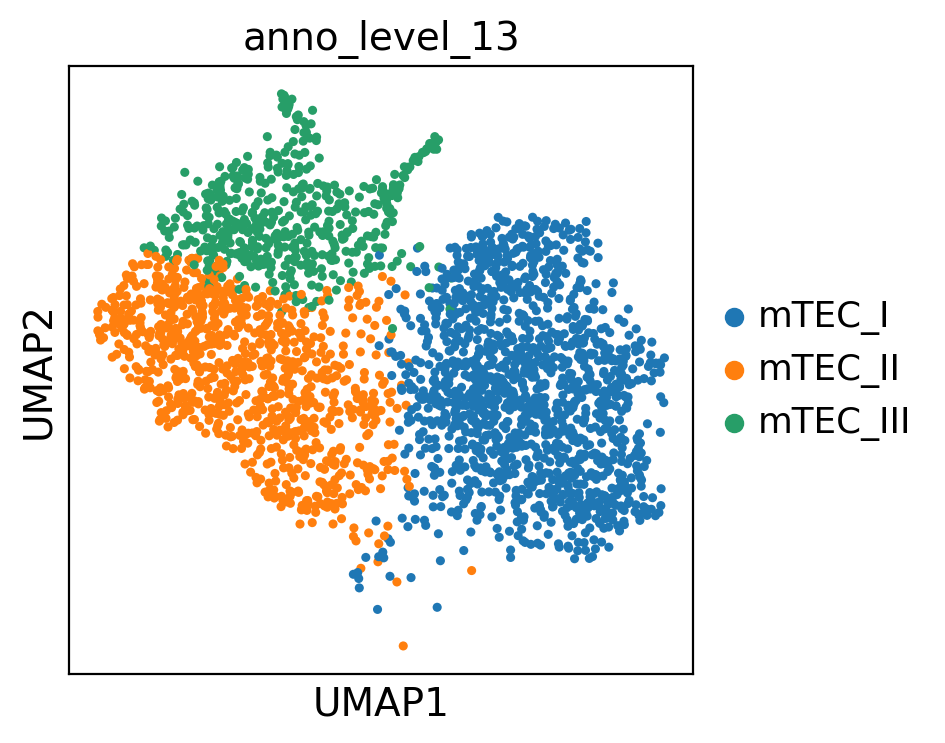

In [956]:
scjp.us(mTEC,'anno_level_13')

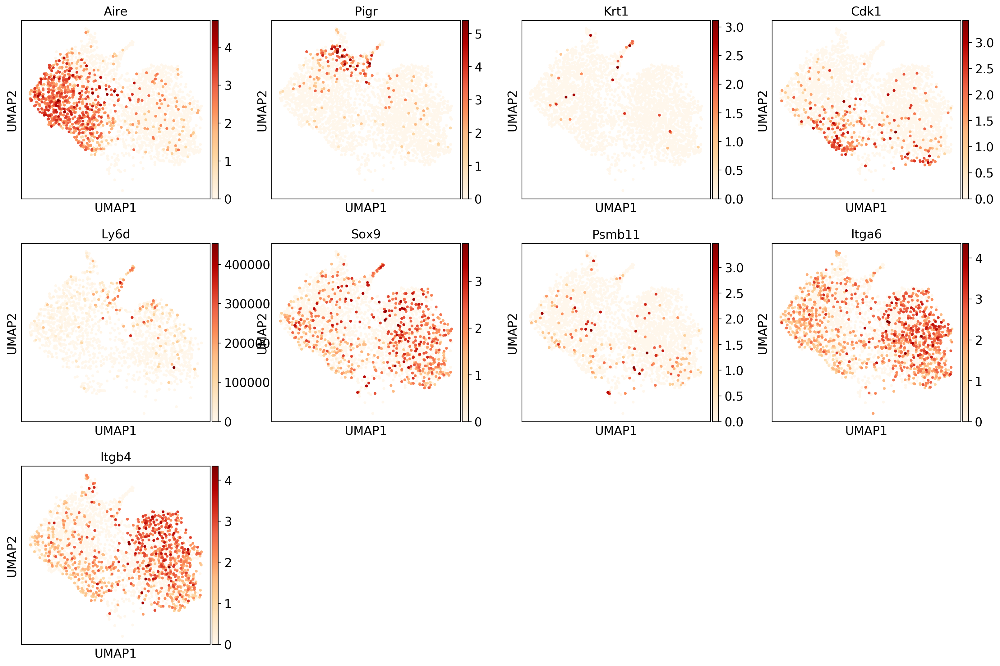

In [952]:
scjp.us(mTEC,'Aire,Pigr,Krt1,Cdk1,Ly6d,Sox9,Psmb11,Itga6,Itgb4')

In [1022]:
model.update_label(mTEC,'anno_level_13',ido,'anno_level_12','anno_level_13',replace=True)

... storing 'anno_level_12' as categorical
... storing 'anno_level_13.replaced.3' as categorical
... storing 'anno_level_13' as categorical


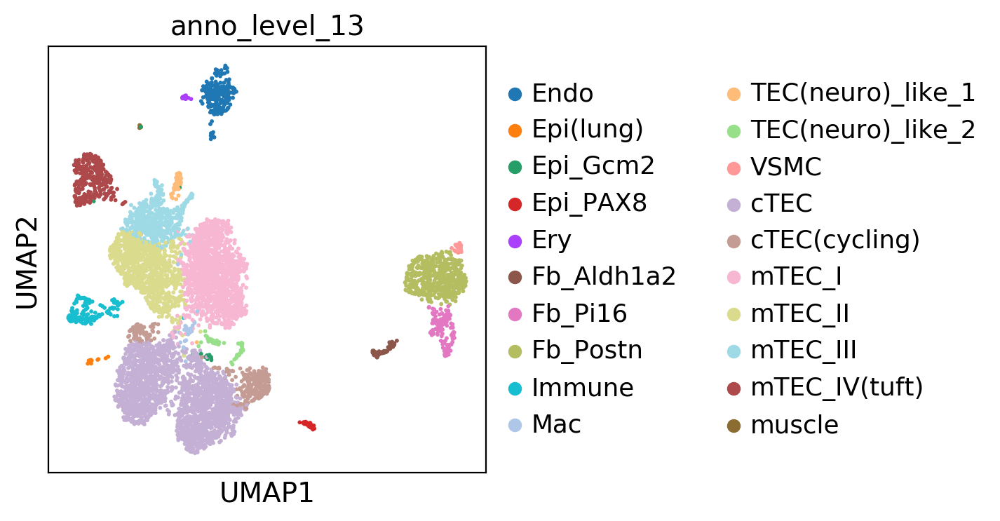

In [1023]:
scjp.us(ido,'anno_level_13')

In [1031]:
neuro = ido[ido.obs['anno_level_13']=='TEC(neuro)_like_2']

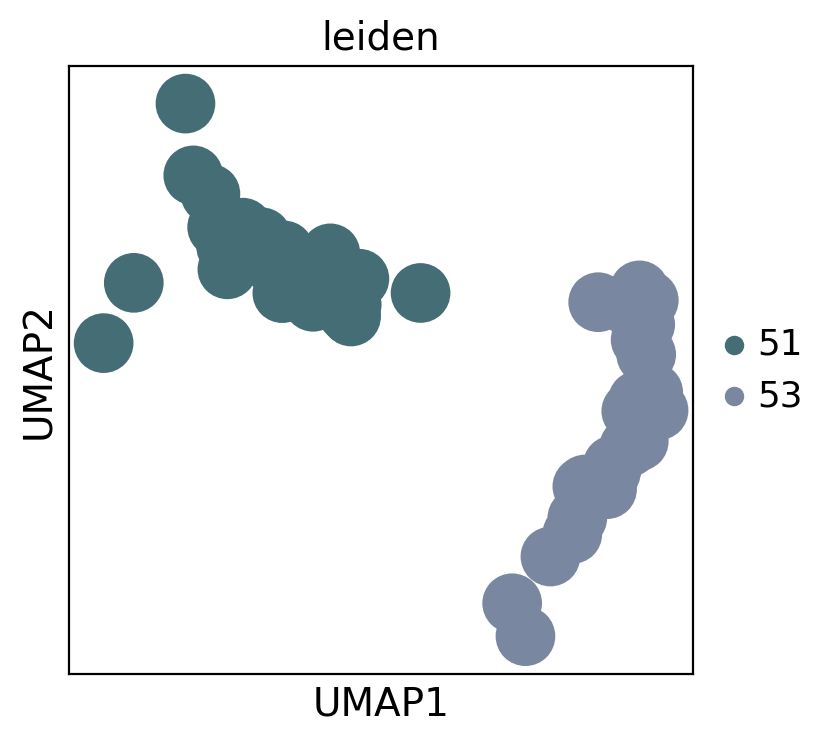

In [1033]:
scjp.us(neuro,'leiden')

In [1034]:
mks = markers.marker(neuro,'leiden')

/mnt/thymus_atlas/scjp/markers.py:180: RuntimeWarning:

invalid value encountered in true_divide



In [1049]:
ann = scjp.annotater(neuro,'anno_level_14')

In [1051]:
ann.update(neuro,'leiden','51','TEC(neuro)_like_2')
ann.update(neuro,'leiden','53','TEC_Cldn10')

In [1052]:
model.update_label(neuro,'anno_level_14',ido,'anno_level_13','anno_level_14')

... storing 'anno_level_14' as categorical


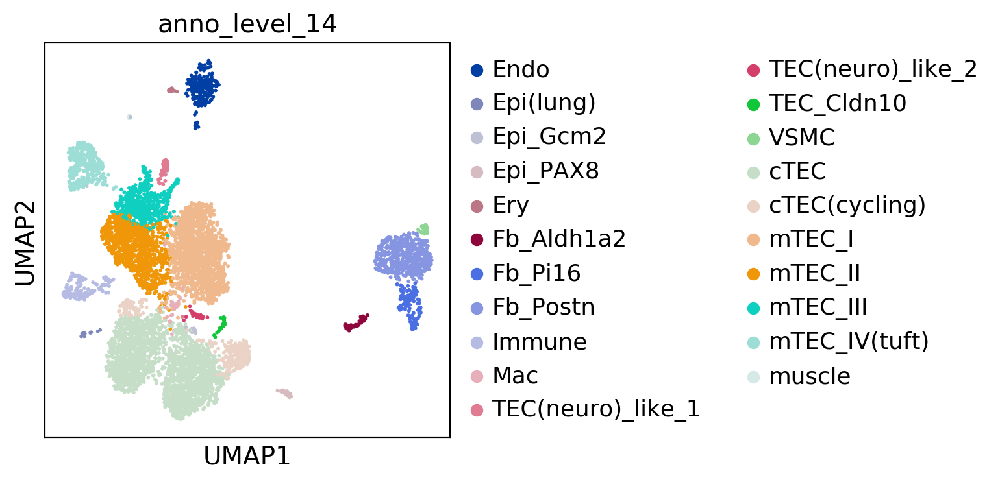

In [1053]:
scjp.us(ido,'anno_level_14')

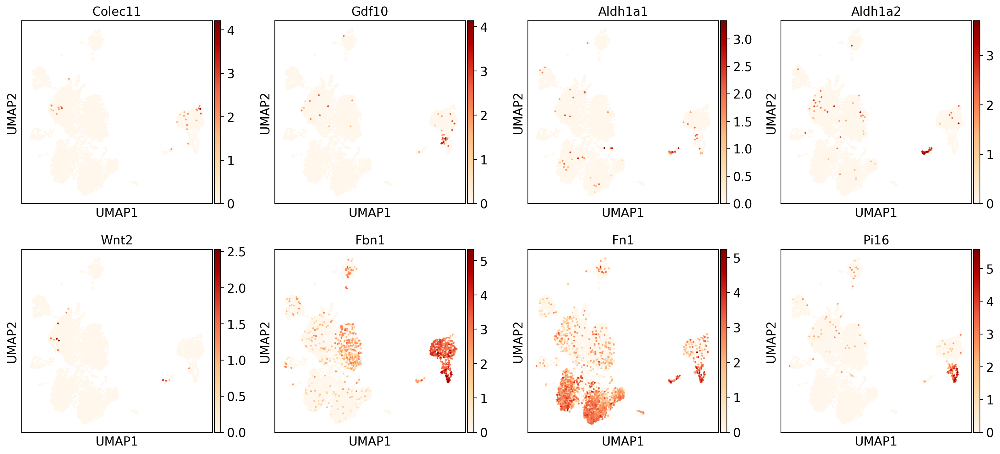

In [1251]:
scjp.us(ido,'Colec11,Gdf10,Aldh1a1,Aldh1a2,Wnt2,Fbn1,Fn1,Pi16')

In [1054]:
scjp.write(ido,version,'ido_annotated')

Only considering the two last: ['.A02', '.ido_annotated'].
HTA08_v01_A02_ido_annotated = 'HTA08.v01.A02.ido_annotated'


## Merging all three dataset

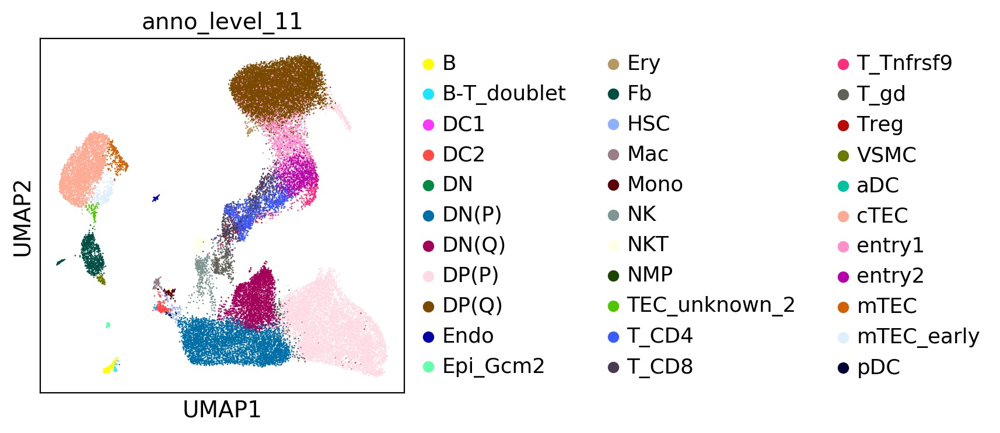

In [1055]:
scjp.us(bdata,'anno_level_11')

In [1056]:
ido_cm, bdata_cm = model.get_common_var_raw(ido,bdata)

calculating a...
calculating b...


In [1100]:
bdata_cm.obs['anno_level_14'] = bdata_cm.obs['anno_level_11']

creating lr model...


/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/home/ubuntu/.local/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:469: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



making lr prediction...
updating lr to adata...


LogisticRegression(C=0.2, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='warn', n_jobs=None, penalty='l2',
                   random_state=None, solver='warn', tol=0.0001, verbose=0,
                   warm_start=False)

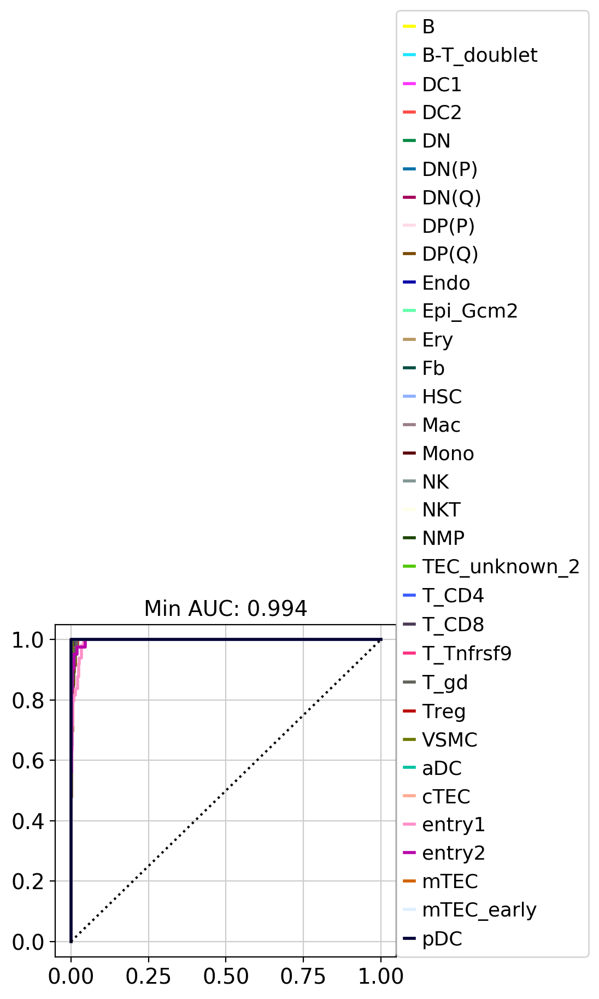

In [1161]:
bdata_cm.obs['anno_merge'] = bdata_cm.obs['anno_level_11']
model.transfer_annotation_jp(bdata_cm,'anno_merge',ido_cm,'anno_merge',raw=False)

In [1162]:
ad = {}
ad['jp'] = bdata_cm[bdata_cm.obs['name']=='jp']
ad['tca'] = bdata_cm[bdata_cm.obs['name']=='tca']
ad['ido'] = ido_cm

In [1163]:
ad['jp'].obs['age'] = [x[2] for x in ad['jp'].obs['Sample'].str.split('_')]

Trying to set attribute `.obs` of view, making a copy.


In [1164]:
ad['ido'].obs['age'] = ad['ido'].obs['mouse age:ch1']

In [1165]:
ad['ido'].obs['Sample'] = list(ido_cm.obs['Experiment_ID'])

In [1166]:
mouse_total = scjp.merge_matrix(ad)

Trying to set attribute `.obs` of view, making a copy.


42979
Sample
n_counts
n_genes
donor
organ
sort
method
file
mito
doublet_scores
predicted_doublets
name
Cycle_score
isCycle
scrublet_doublets
leiden
anno_pred
anno_level_1
anno_level_2
anno_level_4
anno_level_5
anno_level_6
age
anno_level_7
anno_level_8
anno_level_9
trac.replaced.1
trac.replaced.2
trdc.replaced.1
trdc.replaced.2
trac.replaced.3
trac.replaced.4
trdc.replaced.3
trdc.replaced.4
trac.replaced.5
trac.replaced.6
trdc.replaced.5
trdc.replaced.6
trac.replaced.7
trac.replaced.8
trdc.replaced.7
trdc.replaced.8
trac.replaced.9
trac.replaced.10
trdc.replaced.9
trdc.replaced.10
trac.replaced.11
trac.replaced.12
trdc.replaced.11
trdc.replaced.12
trac.replaced.13
trac.replaced.14
trdc.replaced.13
trdc.replaced.14
trac.replaced.15
trdc.replaced.15
trac.replaced.16
trdc.replaced.16
trac.replaced.17
trdc.replaced.17
trac.replaced.18
trdc.replaced.18
trac.replaced.19
trdc.replaced.19
trac.replaced.20
trdc.replaced.20
trac.replaced.21
trdc.replaced.21
trac.replaced.22
trac
trdc.replaced.22

In [1167]:
mouse_total.raw = mouse_total

In [1168]:
scjp.sc_process(mouse_total,pid='fp')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:02.45)


In [1169]:
scjp.bbknn_umap(mouse_total,'name',50)

computing batch balanced neighbors
	finished (0:00:07.41) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50


/home/ubuntu/.local/lib/python3.6/site-packages/umap/spectral.py:229: UserWarning:

Embedding a total of 3 separate connected components using meta-embedding (experimental)



    finished (0:00:25.03) --> added
    'X_umap', UMAP coordinates (adata.obsm)


... storing 'Sample' as categorical
... storing 'donor' as categorical
... storing 'organ' as categorical
... storing 'sort' as categorical
... storing 'method' as categorical
... storing 'file' as categorical
... storing 'mito' as categorical
... storing 'doublet_scores' as categorical
... storing 'predicted_doublets' as categorical
... storing 'name' as categorical
... storing 'Cycle_score' as categorical
... storing 'isCycle' as categorical
... storing 'scrublet_doublets' as categorical
... storing 'leiden' as categorical
... storing 'anno_pred' as categorical
... storing 'anno_level_1' as categorical
... storing 'anno_level_2' as categorical
... storing 'anno_level_4' as categorical
... storing 'anno_level_5' as categorical
... storing 'anno_level_6' as categorical
... storing 'age' as categorical
... storing 'anno_level_7' as categorical
... storing 'anno_level_8' as categorical
... storing 'anno_level_9' as categorical
... storing 'trac.replaced.1' as categorical
... storing 'tra

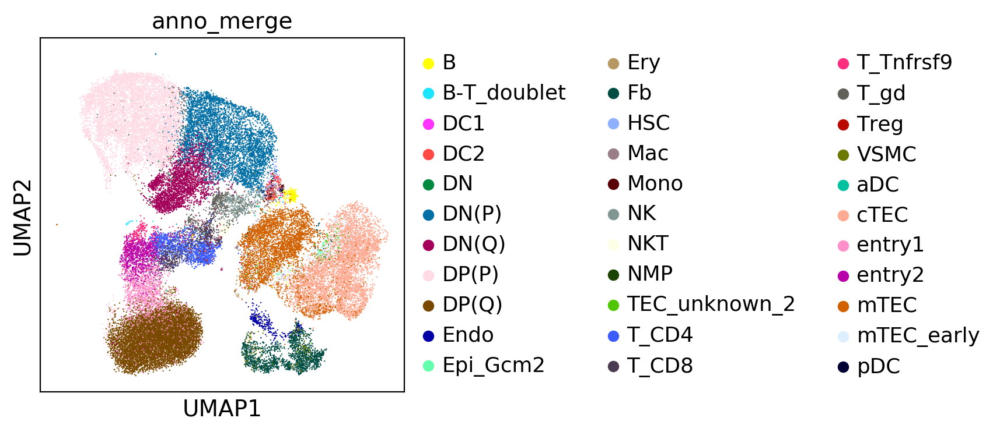

In [1170]:
scjp.us(mouse_total,'anno_merge')

In [1143]:
sc.tl.leiden(mouse_total,resolution=0.2)

running Leiden clustering
    finished (0:00:04.44) --> found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


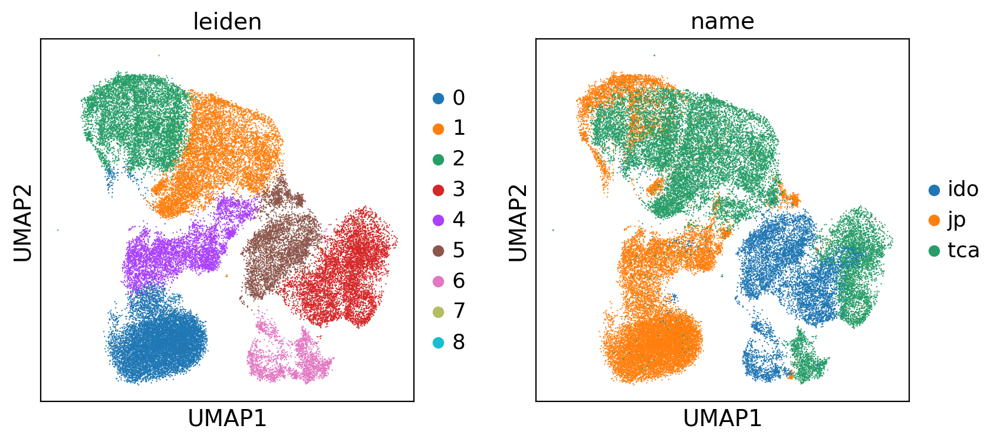

In [1144]:
scjp.us(mouse_total,'leiden,name')

In [1171]:
mouse_total_iter,X_explained = scjp.regress_iter(mouse_total,['name'],['anno_merge'],'Sample')

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:01.66)
computing batch balanced neighbors
	finished (0:00:35.57) --> added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix


In [1172]:
mouse_total_iter.raw = sc.AnnData(mouse_total.raw.X,var=mouse_total.raw.var)

In [1173]:
sc.tl.umap(mouse_total_iter)

computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:01:21.62) --> added
    'X_umap', UMAP coordinates (adata.obsm)


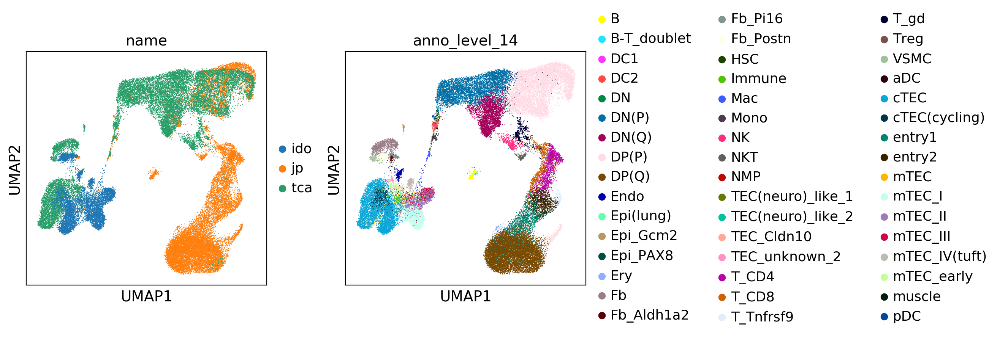

In [1198]:
scjp.us(mouse_total_iter,'name,anno_level_14'.split(','))

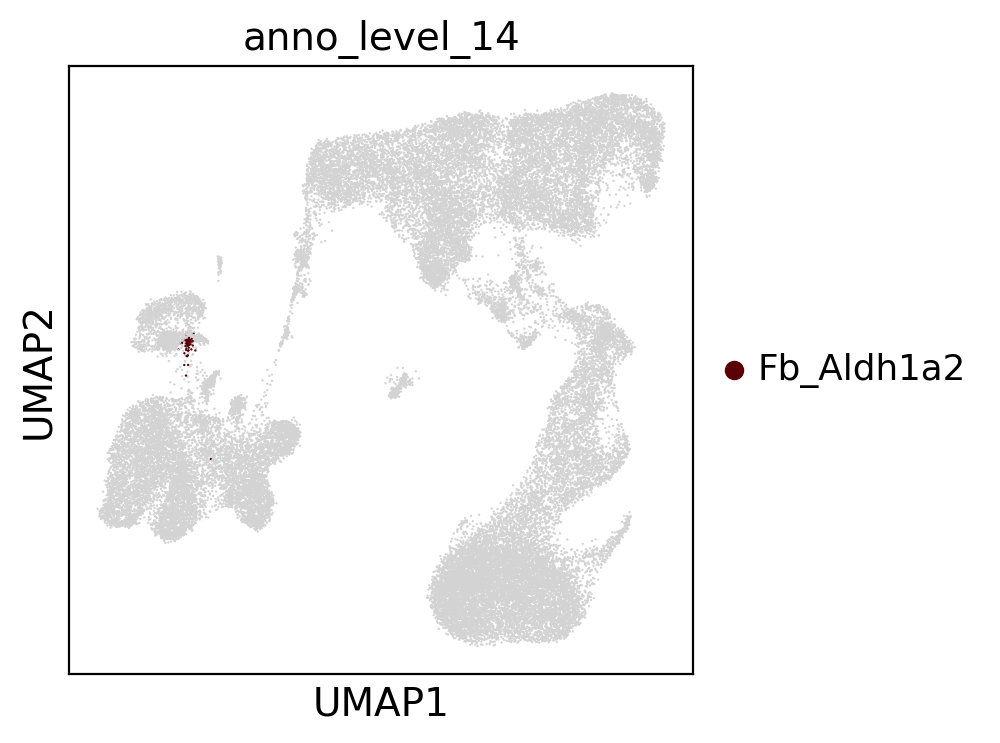

In [1189]:
scjp.us(mouse_total_iter,'anno_level_14',groups=['Fb_Aldh1a2'])

In [1199]:
arr = np.array(mouse_total_iter.obs.trdc,dtype=object)
arr[mouse_total_iter.obs.trdc=='n/a'] = 0
mouse_total_iter.obs['trdc'] = np.array(arr,dtype=float)

In [1200]:
arr = np.array(mouse_total_iter.obs.trac,dtype=object)
arr[mouse_total_iter.obs.trac=='n/a'] = 0
mouse_total_iter.obs['trac'] = np.array(arr,dtype=float)

In [1201]:
scjp.write(mouse_total_iter,version,'mouse_total_final_v2')

Only considering the two last: ['.A02', '.mouse_total_final_v2'].
HTA08_v01_A02_mouse_total_final_v2 = 'HTA08.v01.A02.mouse_total_final_v2'


In [1209]:
mT = scjp.get_subset(mouse_total_iter,mouse_total_iter.obs['anno_level_14'].isin('T_CD4,T_CD8,Treg'.split(',')),cc_genes=mouse_cc_genes)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 50
    finished (0:00:00.86)


In [1210]:
scjp.sc_process(mT,pid='nul')

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00.23) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:00:05.97) --> added
    'X_umap', UMAP coordinates (adata.obsm)
running Leiden clustering
    finished (0:00:00.54) --> found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


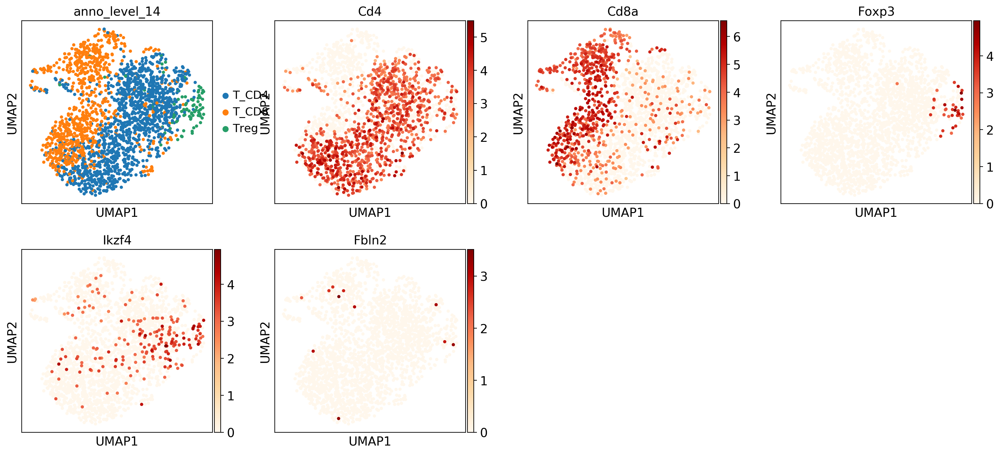

In [1212]:
scjp.us(mT,'anno_level_14,Cd4,Cd8a,Foxp3,Ikzf4,Fbln2')

In [1230]:
hT = sc.read('HTA07.A05.v02.fig2_tdata')

Only considering the two last: ['.v02', '.fig2_tdata'].


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [1233]:
hT.obsm['X_umap'] = hT.obsm['X_umap_2d']

In [1232]:
hT.obsm.keys()

('X_pca', 'X_umap', 'X_umap_2d', 'X_umap_3d')

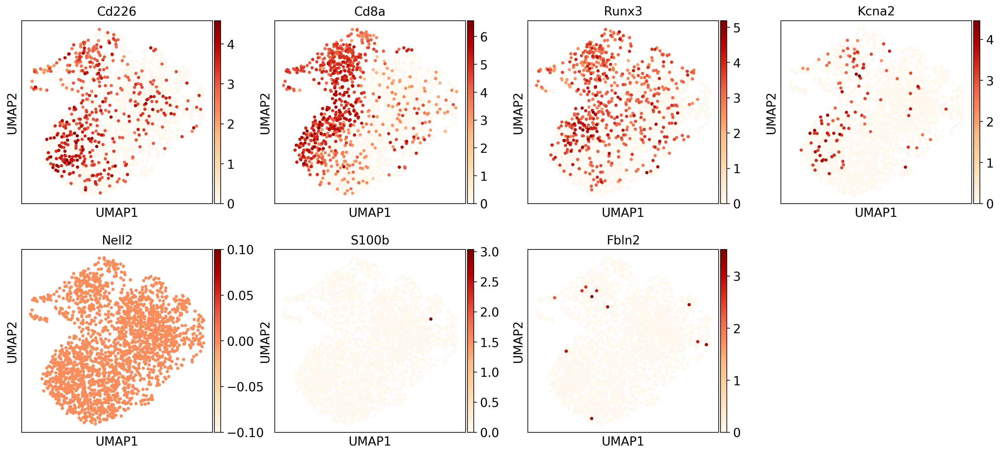

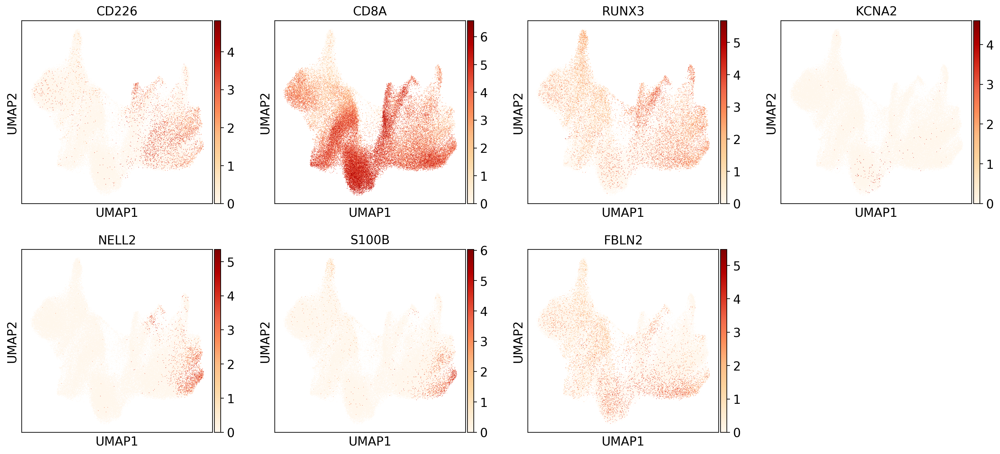

In [1241]:
gene = 'Cd226,Cd8a,Runx3,Kcna2,Nell2,S100b,Fbln2'
scjp.us(mT,gene)
scjp.us(hT,gene.upper())

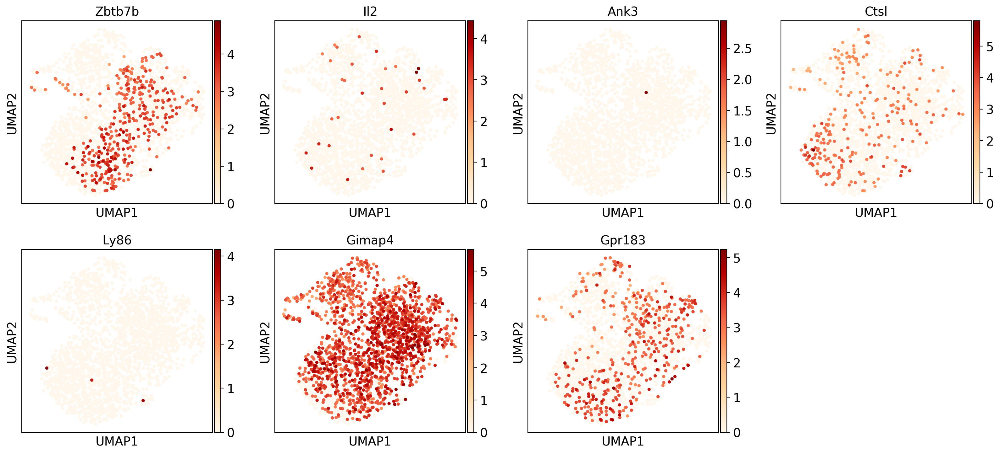

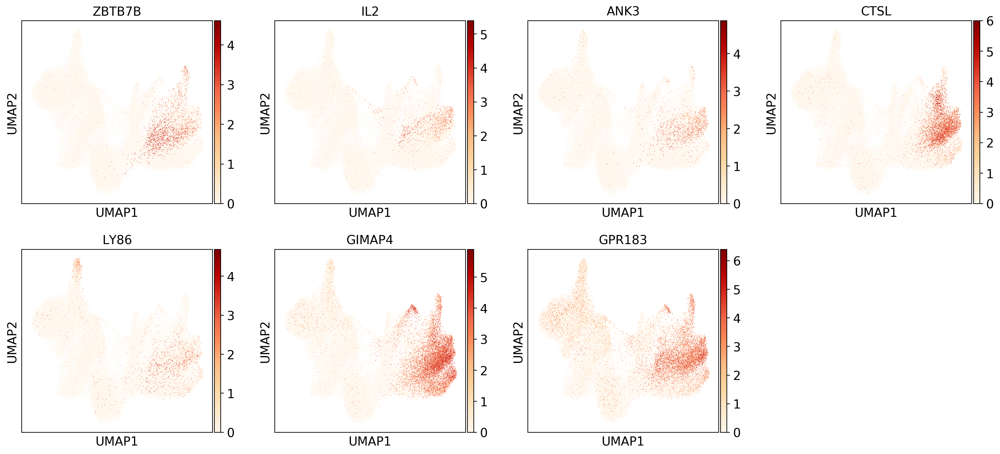

In [1249]:
gene = 'Zbtb7b,Il2,Ank3,Ctsl,Ly86,Gimap4,Gpr183'
scjp.us(mT,gene)
scjp.us(hT,gene.upper())

In [1253]:
' '.join('''4820STDY7388991
4820STDY7388992
4820STDY7388993
4820STDY7388994
4820STDY7388995
4820STDY7388996
4820STDY7388997
4820STDY7388998
4820STDY7388999
4820STDY7389000
4820STDY7389001
4820STDY7389002
4820STDY7389003
4820STDY7389004
4820STDY7389005
4820STDY7389006
4820STDY7389007
4820STDY7389008
4820STDY7389009
4820STDY7389010
4820STDY7389011
4820STDY7389012
4820STDY7389013
4820STDY7389014'''.split('\n'))

'4820STDY7388991 4820STDY7388992 4820STDY7388993 4820STDY7388994 4820STDY7388995 4820STDY7388996 4820STDY7388997 4820STDY7388998 4820STDY7388999 4820STDY7389000 4820STDY7389001 4820STDY7389002 4820STDY7389003 4820STDY7389004 4820STDY7389005 4820STDY7389006 4820STDY7389007 4820STDY7389008 4820STDY7389009 4820STDY7389010 4820STDY7389011 4820STDY7389012 4820STDY7389013 4820STDY7389014'